PUPORSE OF THE PROJECT
We are going to address these problems by analyzing our dataset to gain meaningful insight and understanding of the following;
 Trends and patterns in drug accident-related cases.
Associativity between features
The relationship between variables.
Upon completion of this project, we should be able to make recommendations to the Connecticut drug regulatory Agency on how to control the usage of illicit drugs by suggesting a policy that will help mitigate the problem.
We should also be able to communicate our findings to them for future policy enhancement and regulations.


ABOUT DATASET
The analysis will be based on Accidental Drug Related Deaths 2012-2021 I obtained from Accidental Drug Related Deaths 2012-2021 - Catalog (data.gov)
The dataset included data between 2012 and 2021


IMPORTING NECCESSARY LIBARY

In [2]:
import datetime
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno

ModuleNotFoundError: No module named 'missingno'

LOADING THE CSV FILES

In [3]:
drugs_accidents = pd.read_csv(r'C:\Users\User\PycharmProjects\MSC CONTECH STUDY\Accidental_Drug_Related_Deaths_2012-2021.csv', parse_dates=['Date'],low_memory=False)

DISPLAY FIRST FIVE ROWS

In [4]:
drugs_accidents.head(5)

,Date,Date Type,Age,Sex,Race,Ethnicity,Residence City,Residence County,Residence State,Injury City,...,Xylazine,Gabapentin,Opiate NOS,Heroin/Morph/Codeine,Other Opioid,Any Opioid,Other,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29,Date of death,37.0,Male,Black,NaN,STAMFORD,FAIRFIELD,NaN,STAMFORD,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","CT\n(41.575155, -72.738288)"
1,2012-06-27,Date of death,37.0,Male,White,NaN,NORWICH,NEW LONDON,NaN,NORWICH,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"NORWICH, CT\n(41.524304, -72.075821)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"
2,2014-03-24,Date of death,28.0,Male,White,NaN,HEBRON,NaN,NaN,HEBRON,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Marlborough, CT\n(41.632043, -72.461309)"
3,2014-12-31,Date of death,26.0,Female,White,NaN,BALTIC,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"BALTIC, CT\n(41.617221, -72.085031)","CT\n(41.575155, -72.738288)","Baltic, CT\n(41.617221, -72.085031)"
4,2016-01-16,Date of death,41.0,Male,White,NaN,SHELTON,FAIRFIELD,CT,SHELTON,...,NaN,NaN,NaN,NaN,NaN,Y,NaN,"SHELTON, CT\n(41.316843, -73.092968)","SHELTON, CT\n(41.316843, -73.092968)","Bridgeport, CT\n(41.179195, -73.189476)"


In [5]:
drugs_accidents.style.background_gradient(cmap='coolwarm')

,Date,Date Type,Age,Sex,Race,Ethnicity,Residence City,Residence County,Residence State,Injury City,Injury County,Injury State,Injury Place,Description of Injury,Death City,Death County,Death State,Location,Location if Other,Cause of Death,Manner of Death,Other Significant Conditions,Heroin,Heroin death certificate (DC),Cocaine,Fentanyl,Fentanyl Analogue,Oxycodone,Oxymorphone,Ethanol,Hydrocodone,Benzodiazepine,Methadone,Meth/Amphetamine,Amphet,Tramad,Hydromorphone,Morphine (Not Heroin),Xylazine,Gabapentin,Opiate NOS,Heroin/Morph/Codeine,Other Opioid,Any Opioid,Other,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29 00:00:00,Date of death,37.000000,Male,Black,nan,STAMFORD,FAIRFIELD,nan,STAMFORD,nan,CT,Residence,Used Cocaine,nan,nan,nan,Residence,nan,Cocaine Toxicity,Accident,nan,nan,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"STAMFORD, CT (41.051924, -73.539475)","STAMFORD, CT (41.051924, -73.539475)","CT (41.575155, -72.738288)"
1,2012-06-27 00:00:00,Date of death,37.000000,Male,White,nan,NORWICH,NEW LONDON,nan,NORWICH,nan,CT,Residence,Drug Use,NORWICH,NEW LONDON,nan,Hospital,nan,Heroin Toxicity,Accident,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"NORWICH, CT (41.524304, -72.075821)","NORWICH, CT (41.524304, -72.075821)","Norwich, CT (41.524304, -72.075821)"
2,2014-03-24 00:00:00,Date of death,28.000000,Male,White,nan,HEBRON,nan,nan,HEBRON,nan,CT,Residence,Drug Use,MARLBOROUGH,nan,nan,Hospital,nan,Heroin Intoxication,Accident,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"HEBRON, CT (41.658069, -72.366324)","HEBRON, CT (41.658069, -72.366324)","Marlborough, CT (41.632043, -72.461309)"
3,2014-12-31 00:00:00,Date of death,26.000000,Female,White,nan,BALTIC,nan,nan,nan,nan,nan,nan,nan,BALTIC,NEW LONDON,nan,Residence,nan,Acute Heroin Intoxication,Accident,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"BALTIC, CT (41.617221, -72.085031)","CT (41.575155, -72.738288)","Baltic, CT (41.617221, -72.085031)"
4,2016-01-16 00:00:00,Date of death,41.000000,Male,White,nan,SHELTON,FAIRFIELD,CT,SHELTON,nan,nan,Residence,Drug Use,BRIDGEPORT,nan,nan,Hospital,nan,Acute Fentanyl Intoxication,Accident,nan,nan,nan,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,Y,nan,"SHELTON, CT (41.316843, -73.092968)","SHELTON, CT (41.316843, -73.092968)","Bridgeport, CT (41.179195, -73.189476)"
5,2017-06-13 00:00:00,Date reported,57.000000,Male,White,nan,BLANDFORD,HAMPDEN,MA,ENFIELD,HARTFORD,CT,In Vehicle,Drug abuse,ENFIELD,HARTFORD,CT,Other,Roadway in vehicle,Acute Intoxication Cocaine Toxicity,Accident,nan,nan,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"ENFIELD, CT (41.976501, -72.591985)","Enfield, CT (41.976501, -72.591985)"
6,2015-10-20 00:00:00,Date reported,26.000000,Male,White,nan,DANBURY,FAIRFIELD,CT,DANBURY,nan,nan,Residence,nan,DANBURY,FAIRFIELD,CT,Hospital,nan,Acute Opioid Intoxication,Accident,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,Y,nan,"DANBURY, CT (41.393666, -73.451539)","DANBURY, CT (41.393666, -73.451539)","Danbury, CT (41.393666, -73.451539)"
7,2017-02-02 00:00:00,Date reported,64.000000,Male,White,nan,MILFORD,NEW HAVEN,CT,MILFORD,NEW HAVEN,CT,Residence,Ingestion,MILFORD,NEW HAVEN,CT,Residence,nan,Acute Oxycodone Intoxication,Accident,nan,nan,nan,nan,nan,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"MILFORD, CT (41.224276, -73.057564)","MILFORD, CT (41.224276, -73.057564)","Milford, CT (41.224276, -73.057564)"
8,2018-07-03 00:00:00,Date of death,33.000000,Male,nan,nan,nan,nan,nan,HARTFORD,HARTFORD,nan,Building,Drug Use,HARTFORD,HARTFORD,CT,Other,nan,Acute Cocaine Intoxication,Accident,nan,nan,nan,Y,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,"CT (41.575155, -72.738288

RENAME COLUMNS

In [6]:
dic={'Date Type':'Incident','Age':'Age','Residence City':'Residence_City','Residence County':'Residence_County','Residence State':'Residence_State','Injury City':'Injury_City','Injury County':'Injury_County','Injury State':'Injury_State','Injury Place':'Injury_Place','Description of Injury':'Injury_Description','Death City':'Death_City','Death County':'Death_County','Death State':'Death_State','Location':'Death_Place','Location if Other':'Unknown_Death_Place','Cause of Death':'Cause_of_Death','Manner of Death':'Death_Manner','Asian Indian ':np.nan}
drugs_accidents.rename(columns=dic,inplace=True)
drugs_accidents.sample(5)

,Date,Incident,Age,Sex,Race,Ethnicity,Residence_City,Residence_County,Residence_State,Injury_City,...,Xylazine,Gabapentin,Opiate NOS,Heroin/Morph/Codeine,Other Opioid,Any Opioid,Other,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
1158,2018-05-05,Date of death,34.0,Male,White,NaN,TERRYVILLE,NaN,CT,WATERTOWN,...,NaN,NaN,NaN,Y,NaN,Y,NaN,"TERRYVILLE, CT\n(41.678437, -73.011233)","WATERTOWN, CT\n(41.606284, -73.11839)","Waterbury, CT\n(41.554261, -73.043069)"
6330,2018-05-18,Date of death,24.0,Male,White,NaN,NORWALK,FAIRFIELD,CT,NORWALK,...,NaN,NaN,NaN,Y,NaN,Y,NaN,"NORWALK, CT\n(41.11805, -73.412906)","NORWALK, CT\n(41.11805, -73.412906)","Norwalk, CT\n(41.11805, -73.412906)"
2099,2016-10-03,Date of death,18.0,Male,White,NaN,NORWALK,FAIRFIELD,CT,STORRS,...,NaN,NaN,NaN,NaN,NaN,Y,NaN,"NORWALK, CT\n(41.11805, -73.412906)","STORRS, CT\n(41.801124, -72.240997)","Storrs, CT\n(41.801124, -72.240997)"
2352,2019-05-03,Date of death,64.0,Male,White,NaN,NEW HAVEN,NEW HAVEN,CT,NEW HAVEN,...,NaN,NaN,NaN,Y,NaN,Y,NaN,"NEW HAVEN, CT\n(41.308252, -72.924161)","NEW HAVEN, CT\n(41.308252, -72.924161)","New Haven, CT\n(41.308252, -72.924161)"
6646,2014-03-04,Date of death,56.0,Female,White,NaN,WATERBURY,NaN,NaN,WATEBURY,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"WATERBURY, CT\n(41.554261, -73.043069)","WATEBURY, CT\n(41.545058, -73.208654)","Waterbury, CT\n(41.554261, -73.043069)"


EXTRACT USEFUL COLUMNS

In [7]:
drugs_accidents = drugs_accidents[['Date','Incident','Age','Sex','Race','Ethnicity','Residence_County','Residence_State','Residence_City','Injury_County','Injury_State','Injury_City','Injury_Place','Injury_Description','Death_County','Death_State','Death_City','Death_Place','Unknown_Death_Place','Cause_of_Death','Death_Manner','ResidenceCityGeo','InjuryCityGeo','DeathCityGeo']]
drugs_accidents

,Date,Incident,Age,Sex,Race,Ethnicity,Residence_County,Residence_State,Residence_City,Injury_County,...,Death_County,Death_State,Death_City,Death_Place,Unknown_Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29,Date of death,37.0,Male,Black,NaN,FAIRFIELD,NaN,STAMFORD,NaN,...,NaN,NaN,NaN,Residence,NaN,Cocaine Toxicity,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","CT\n(41.575155, -72.738288)"
1,2012-06-27,Date of death,37.0,Male,White,NaN,NEW LONDON,NaN,NORWICH,NaN,...,NEW LONDON,NaN,NORWICH,Hospital,NaN,Heroin Toxicity,Accident,"NORWICH, CT\n(41.524304, -72.075821)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"
2,2014-03-24,Date of death,28.0,Male,White,NaN,NaN,NaN,HEBRON,NaN,...,NaN,NaN,MARLBOROUGH,Hospital,NaN,Heroin Intoxication,Accident,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Marlborough, CT\n(41.632043, -72.461309)"
3,2014-12-31,Date of death,26.0,Female,White,NaN,NaN,NaN,BALTIC,NaN,...,NEW LONDON,NaN,BALTIC,Residence,NaN,Acute Heroin Intoxication,Accident,"BALTIC, CT\n(41.617221, -72.085031)","CT\n(41.575155, -72.738288)","Baltic, CT\n(41.617221, -72.085031)"
4,2016-01-16,Date of death,41.0,Male,White,NaN,FAIRFIELD,CT,SHELTON,NaN,...,NaN,NaN,BRIDGEPORT,Hospital,NaN,Acute Fentanyl Intoxication,Accident,"SHELTON, CT\n(41.316843, -73.092968)","SHELTON, CT\n(41.316843, -73.092968)","Bridgeport, CT\n(41.179195, -73.189476)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9197,2021-10-19,Date of death,56.0,Male,Black or African American,NaN,FAIRFIELD,CT,STAMFORD,FAIRFIELD,...,FAIRFIELD,CT,STAMFORD,Other,Hallway at friend's residene,Acute Intoxication by the Combined Effects of ...,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","Stamford, CT\n(41.051924, -73.539475)"
9198,2021-05-04,Date of death,48.0,Male,Black or African American,NaN,NEW HAVEN,CT,WEST HAVEN,NEW HAVEN,...,NEW HAVEN,CT,NEW HAVEN,Hospital - Inpatient,NaN,Complications of Acute Substance Intoxication ...,Accident,"WEST HAVEN, CT\n(41.272336, -72.949817)","WEST HAVEN, CT\n(41.272336, -72.949817)","New Haven, CT\n(41.308252, -72.924161)"
9199,2021-05-15,Date of death,59.0,Male,White,NaN,HARTFORD,CT,WETHERSFIELD,HARTFORD,...,HARTFORD,CT,HARTFORD,Hospital - ER/Outpatient,NaN,Acute Intoxication by the Combined Effects of ...,Accident,"WETHERSFIELD, CT\n(41.712487, -72.663607)","WETHERSFIELD, CT\n(41.712487, -72.663607)","Hartford, CT\n(41.765775, -72.673356)"
9200,2021-05-28,Date of death,68.0,Male,Black or African American,NaN,HARTFORD,CT,HARTFORD,HARTFORD,...,HARTFORD,CT,HARTFORD,Residence,NaN,Acute Cocaine Intoxication,Accident,"HARTFORD, CT\n(41.765775, -72.673356)","HARTFORD, CT\n(41.765775, -72.673356)","Hartford, CT\n(41.765775, -72.673356)"


In [8]:
drugs_accidents.select_dtypes(include=np.number).style.background_gradient(cmap='coolwarm')

DESCRIPTIVE STATISTICS

Stastical Summary of Dataset

In [9]:
drugs_accidents.describe(include='all')

C:\Users\User\AppData\Local\Temp\ipykernel_7832\2984594611.py:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  drugs_accidents.describe(include='all')


,Date,Incident,Age,Sex,Race,Ethnicity,Residence_County,Residence_State,Residence_City,Injury_County,...,Death_County,Death_State,Death_City,Death_Place,Unknown_Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
count,9202,9202,9200.000000,9194,9178,1287,8160,7426,8813,5914,...,8090,6873,9197,9180,839,9202,9193,9037,8991,9201
unique,3163,2,NaN,2,13,5,135,32,485,16,...,10,2,238,13,441,6017,5,348,275,238
top,2021-05-27 00:00:00,Date of death,NaN,Male,White,Hispanic,NEW HAVEN,CT,HARTFORD,NEW HAVEN,...,HARTFORD,CT,HARTFORD,Residence,Friend's Residence,Acute Fentanyl Intoxication,Accident,"HARTFORD, CT\n(41.765775, -72.673356)","HARTFORD, CT\n(41.765775, -72.673356)","Hartford, CT\n(41.765775, -72.673356)"
freq,12,7435,NaN,6826,7951,972,2289,7171,596,1763,...,2441,6872,1083,4799,52,416,9164,596,775,1083
first,2012-01-01 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
last,2021-12-31 00:00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,NaN,NaN,43.023370,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,12.502644,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,14.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,33.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


CHECKING DATATYPES AND NUMBERS OF MISSING VALUES PER COLUMN

In [10]:
drugs_accidents.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9202 entries, 0 to 9201
Data columns (total 24 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Date                 9202 non-null   datetime64[ns]
 1   Incident             9202 non-null   object        
 2   Age                  9200 non-null   float64       
 3   Sex                  9194 non-null   object        
 4   Race                 9178 non-null   object        
 5   Ethnicity            1287 non-null   object        
 6   Residence_County     8160 non-null   object        
 7   Residence_State      7426 non-null   object        
 8   Residence_City       8813 non-null   object        
 9   Injury_County        5914 non-null   object        
 10  Injury_State         6290 non-null   object        
 11  Injury_City          9024 non-null   object        
 12  Injury_Place         9100 non-null   object        
 13  Injury_Description   8411 non-nul

Display the rows

In [11]:
drugs_accidents.index

RangeIndex(start=0, stop=9202, step=1)

View the Columns

In [12]:
drugs_accidents.columns

Index(['Date', 'Incident', 'Age', 'Sex', 'Race', 'Ethnicity',
       'Residence_County', 'Residence_State', 'Residence_City',
       'Injury_County', 'Injury_State', 'Injury_City', 'Injury_Place',
       'Injury_Description', 'Death_County', 'Death_State', 'Death_City',
       'Death_Place', 'Unknown_Death_Place', 'Cause_of_Death', 'Death_Manner',
       'ResidenceCityGeo', 'InjuryCityGeo', 'DeathCityGeo'],
      dtype='object')

Checking dataset shape

In [13]:
drugs_accidents.shape

(9202, 24)

checking data types

In [14]:
drugs_accidents.dtypes

Date                   datetime64[ns]
Incident                       object
Age                           float64
Sex                            object
Race                           object
Ethnicity                      object
Residence_County               object
Residence_State                object
Residence_City                 object
Injury_County                  object
Injury_State                   object
Injury_City                    object
Injury_Place                   object
Injury_Description             object
Death_County                   object
Death_State                    object
Death_City                     object
Death_Place                    object
Unknown_Death_Place            object
Cause_of_Death                 object
Death_Manner                   object
ResidenceCityGeo               object
InjuryCityGeo                  object
DeathCityGeo                   object
dtype: object

Checking unique values accross rows

In [15]:
print(drugs_accidents.nunique(axis=0))

Date                   3163
Incident                  2
Age                      68
Sex                       2
Race                     13
Ethnicity                 5
Residence_County        135
Residence_State          32
Residence_City          485
Injury_County            16
Injury_State              6
Injury_City             289
Injury_Place             91
Injury_Description      426
Death_County             10
Death_State               2
Death_City              238
Death_Place              13
Unknown_Death_Place     441
Cause_of_Death         6017
Death_Manner              5
ResidenceCityGeo        348
InjuryCityGeo           275
DeathCityGeo            238
dtype: int64


Checking unique values across columns

In [16]:
drugs_accidents.nunique(axis=1)

0       14
1       15
2       15
3       13
4       16
        ..
9197    16
9198    15
9199    15
9200    13
9201    16
Length: 9202, dtype: int64

DATA CLEANING PROCESS

In [17]:
drugs_accidents.dtypes.value_counts()

object            22
datetime64[ns]     1
float64            1
dtype: int64

Rename Rows

In [18]:
idx= {'Date of death':'Death Recorded','Date reported':'Death reported','Black or African American':'African American','Unknown':'Unknown Victim','American Indian or Alaska Native':'American_Indian','Asian Indian ':'Asian Indian','accident':'Accident'}
drugs_accidents.replace(idx,inplace=True)
drugs_accidents.head(5)

C:\Users\User\AppData\Local\Temp\ipykernel_7832\3688476149.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  drugs_accidents.replace(idx,inplace=True)


,Date,Incident,Age,Sex,Race,Ethnicity,Residence_County,Residence_State,Residence_City,Injury_County,...,Death_County,Death_State,Death_City,Death_Place,Unknown_Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29,Death Recorded,37.0,Male,Black,NaN,FAIRFIELD,NaN,STAMFORD,NaN,...,NaN,NaN,NaN,Residence,NaN,Cocaine Toxicity,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","CT\n(41.575155, -72.738288)"
1,2012-06-27,Death Recorded,37.0,Male,White,NaN,NEW LONDON,NaN,NORWICH,NaN,...,NEW LONDON,NaN,NORWICH,Hospital,NaN,Heroin Toxicity,Accident,"NORWICH, CT\n(41.524304, -72.075821)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"
2,2014-03-24,Death Recorded,28.0,Male,White,NaN,NaN,NaN,HEBRON,NaN,...,NaN,NaN,MARLBOROUGH,Hospital,NaN,Heroin Intoxication,Accident,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Marlborough, CT\n(41.632043, -72.461309)"
3,2014-12-31,Death Recorded,26.0,Female,White,NaN,NaN,NaN,BALTIC,NaN,...,NEW LONDON,NaN,BALTIC,Residence,NaN,Acute Heroin Intoxication,Accident,"BALTIC, CT\n(41.617221, -72.085031)","CT\n(41.575155, -72.738288)","Baltic, CT\n(41.617221, -72.085031)"
4,2016-01-16,Death Recorded,41.0,Male,White,NaN,FAIRFIELD,CT,SHELTON,NaN,...,NaN,NaN,BRIDGEPORT,Hospital,NaN,Acute Fentanyl Intoxication,Accident,"SHELTON, CT\n(41.316843, -73.092968)","SHELTON, CT\n(41.316843, -73.092968)","Bridgeport, CT\n(41.179195, -73.189476)"


Drop empty rows

In [19]:
drugs_accidents.drop((drugs_accidents[drugs_accidents['Death_Manner']=='ACCIDENT']).index,inplace=True)

C:\Users\User\AppData\Local\Temp\ipykernel_7832\1889696595.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  drugs_accidents.drop((drugs_accidents[drugs_accidents['Death_Manner']=='ACCIDENT']).index,inplace=True)


In [20]:
# I tried to convert Age to category but didn't work for me  
#drugs_accidents[drugs_accidents["Age"]<=30.0].replace({'drugs_accidents[drugs_accidents["Age"]<=30.0]':'Tenager'},inplace =True)

In [21]:
# Tried to map the a list of age group to my dataset so that I can convert the age into categorical variable but it didn't work so I used the float data type like that
"""for i in drugs_accidents.Age:
    if i <=30:
        drugs_accidents.Age = "young Victims"
    elif i >= 50:
        drugs_accidents.Age='Middle Age Victims'
    else:
        drugs_accidents.Age='Aged Victims' """

'for i in drugs_accidents.Age:\n    if i <=30:\n        drugs_accidents.Age = "young Victims"\n    elif i >= 50:\n        drugs_accidents.Age=\'Middle Age Victims\'\n    else:\n        drugs_accidents.Age=\'Aged Victims\' '

In [22]:
#Thesame thing happen here.

,"""for rows in drugs_accidents.Age:
    if rows <= 30.0:
        print("Young People")
    elif rows >= 30.0 and rows <= 50.0:
        print('Middle Age')
    elif rows >50.0:
        print("Aged")
    drugs_accidents.replace(drugs_accidents[rows],inplace=True)"""


'for("rows", "in", "drugs_accidents.Age:")\n    if rows <= 30.0:\n        print("Young People")\n    elif rows >= 30.0 and rows <= 50.0:\n        print(\'Middle Age\')\n    elif rows >50.0:\n        print("Aged")\n    drugs_accidents.replace(drugs_accidents[rows],inplace=True)'

In [23]:
#Here too!
"""def Age_Category(Age):
    for rows in drugs_accidents.Age:
        if rows <= 30.0:
          print("Young People")
        elif rows >= 30.0 and rows <= 50.0:
            print('Middle Age')
        elif rows >50.0:
            print("Aged")
        pass

drugs_accidents.Age.apply(Age_Category)"""

'def Age_Category(Age):\n    for rows in drugs_accidents.Age:\n        if rows <= 30.0:\n          print("Young People")\n        elif rows >= 30.0 and rows <= 50.0:\n            print(\'Middle Age\')\n        elif rows >50.0:\n            print("Aged")\n        pass\n\ndrugs_accidents.Age.apply(Age_Category)'

In [24]:
drugs_accidents.Age.head(6)

0    37.0
1    37.0
2    28.0
3    26.0
4    41.0
5    57.0
Name: Age, dtype: float64

Subsetting list of column names to check for duplicates

In [25]:
# defining duplicate list
columns_names = ["Incident",'Race','Residence_State']
# subsettin duplicates list of columns names and keep all duplicates by setting duplicate list to false
duplicates = drugs_accidents.duplicated(subset=columns_names,keep =False)
duplicates

0       True
1       True
2       True
3       True
4       True
        ... 
9197    True
9198    True
9199    True
9200    True
9201    True
Length: 9201, dtype: bool

In [26]:
drugs_accidents[duplicates]

,Date,Incident,Age,Sex,Race,Ethnicity,Residence_County,Residence_State,Residence_City,Injury_County,...,Death_County,Death_State,Death_City,Death_Place,Unknown_Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29,Death Recorded,37.0,Male,Black,NaN,FAIRFIELD,NaN,STAMFORD,NaN,...,NaN,NaN,NaN,Residence,NaN,Cocaine Toxicity,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","CT\n(41.575155, -72.738288)"
1,2012-06-27,Death Recorded,37.0,Male,White,NaN,NEW LONDON,NaN,NORWICH,NaN,...,NEW LONDON,NaN,NORWICH,Hospital,NaN,Heroin Toxicity,Accident,"NORWICH, CT\n(41.524304, -72.075821)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"
2,2014-03-24,Death Recorded,28.0,Male,White,NaN,NaN,NaN,HEBRON,NaN,...,NaN,NaN,MARLBOROUGH,Hospital,NaN,Heroin Intoxication,Accident,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Marlborough, CT\n(41.632043, -72.461309)"
3,2014-12-31,Death Recorded,26.0,Female,White,NaN,NaN,NaN,BALTIC,NaN,...,NEW LONDON,NaN,BALTIC,Residence,NaN,Acute Heroin Intoxication,Accident,"BALTIC, CT\n(41.617221, -72.085031)","CT\n(41.575155, -72.738288)","Baltic, CT\n(41.617221, -72.085031)"
4,2016-01-16,Death Recorded,41.0,Male,White,NaN,FAIRFIELD,CT,SHELTON,NaN,...,NaN,NaN,BRIDGEPORT,Hospital,NaN,Acute Fentanyl Intoxication,Accident,"SHELTON, CT\n(41.316843, -73.092968)","SHELTON, CT\n(41.316843, -73.092968)","Bridgeport, CT\n(41.179195, -73.189476)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9197,2021-10-19,Death Recorded,56.0,Male,African American,NaN,FAIRFIELD,CT,STAMFORD,FAIRFIELD,...,FAIRFIELD,CT,STAMFORD,Other,Hallway at friend's residene,Acute Intoxication by the Combined Effects of ...,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","Stamford, CT\n(41.051924, -73.539475)"
9198,2021-05-04,Death Recorded,48.0,Male,African American,NaN,NEW HAVEN,CT,WEST HAVEN,NEW HAVEN,...,NEW HAVEN,CT,NEW HAVEN,Hospital - Inpatient,NaN,Complications of Acute Substance Intoxication ...,Accident,"WEST HAVEN, CT\n(41.272336, -72.949817)","WEST HAVEN, CT\n(41.272336, -72.949817)","New Haven, CT\n(41.308252, -72.924161)"
9199,2021-05-15,Death Recorded,59.0,Male,White,NaN,HARTFORD,CT,WETHERSFIELD,HARTFORD,...,HARTFORD,CT,HARTFORD,Hospital - ER/Outpatient,NaN,Acute Intoxication by the Combined Effects of ...,Accident,"WETHERSFIELD, CT\n(41.712487, -72.663607)","WETHERSFIELD, CT\n(41.712487, -72.663607)","Hartford, CT\n(41.765775, -72.673356)"
9200,2021-05-28,Death Recorded,68.0,Male,African American,NaN,HARTFORD,CT,HARTFORD,HARTFORD,...,HARTFORD,CT,HARTFORD,Residence,NaN,Acute Cocaine Intoxication,Accident,"HARTFORD, CT\n(41.765775, -72.673356)","HARTFORD, CT\n(41.765775, -72.673356)","Hartford, CT\n(41.765775, -72.673356)"


`check again for duplicates again with isin() method

In [27]:
~duplicates.isin(drugs_accidents)

0       True
1       True
2       True
3       True
4       True
        ... 
9197    True
9198    True
9199    True
9200    True
9201    True
Length: 9201, dtype: bool

In [28]:
drugs_accidents[duplicates].sort_values(by= 'Date')

,Date,Incident,Age,Sex,Race,Ethnicity,Residence_County,Residence_State,Residence_City,Injury_County,...,Death_County,Death_State,Death_City,Death_Place,Unknown_Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
247,2012-01-01,Death Recorded,35.0,Male,White,NaN,TOLLAND,NaN,HEBRON,NaN,...,TOLLAND,NaN,HEBRON,Residence,NaN,Cocaine and Heroin Toxicity,Accident,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Hebron, CT\n(41.658069, -72.366324)"
2129,2012-01-03,Death Recorded,41.0,Male,White,NaN,HARTFORD,NaN,BRISTOL,NaN,...,HARTFORD,NaN,BRISTOL,Hospital,NaN,Multiple Drug Toxicity,Accident,"BRISTOL, CT\n(41.673037, -72.945791)","BRISTOL, CT\n(41.673037, -72.945791)","Bristol, CT\n(41.673037, -72.945791)"
1161,2012-01-04,Death Recorded,61.0,Male,Black,NaN,FAIRFIELD,NaN,DANBURY,NaN,...,FAIRFIELD,NaN,DANBURY,Hospital,NaN,Cocaine Toxicity,Accident,"DANBURY, CT\n(41.393666, -73.451539)","DANBURY, CT\n(41.393666, -73.451539)","Danbury, CT\n(41.393666, -73.451539)"
861,2012-01-05,Death Recorded,51.0,Male,White,NaN,FAIRFIELD,NaN,STRATFORD,NaN,...,FAIRFIELD,NaN,BRIDGEPORT,Other,Mother's Home,Methadone Toxicity,Accident,"STRATFORD, CT\n(41.200888, -73.131323)","STRATFORD, CT\n(41.200888, -73.131323)","Bridgeport, CT\n(41.179195, -73.189476)"
3977,2012-01-07,Death Recorded,45.0,Male,White,NaN,HARTFORD,NaN,HARTFORD,NaN,...,HARTFORD,NaN,HARTFORD,Residence,NaN,Heroin Toxicity,Accident,"HARTFORD, CT\n(41.765775, -72.673356)","HARTFORD, CT\n(41.765775, -72.673356)","Hartford, CT\n(41.765775, -72.673356)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9057,2021-12-30,Death Recorded,33.0,Male,White,Not Spanish/Hispanic/Latino,LITCHFIELD,CT,LAKEVILLE,LITCHFIELD,...,LITCHFIELD,CT,LAKEVILLE,Other (Specify),House,Acute Intoxication by the Combined Effects of ...,Accident,"LAKEVILLE, CT\n(41.958312, -73.437314)","LAKEVILLE, CT\n(41.958312, -73.437314)","Lakeville, CT\n(41.958312, -73.437314)"
9025,2021-12-30,Death Recorded,38.0,Female,White,NaN,NaN,NaN,NaN,NEW HAVEN,...,NEW HAVEN,CT,NEW HAVEN,Hospital - ER/Outpatient,NaN,Acute Intoxication From the Combined Effects o...,Accident,"CT\n(41.575155, -72.738288)","NEW HAVEN, CT\n(41.308252, -72.924161)","New Haven, CT\n(41.308252, -72.924161)"
9195,2021-12-31,Death Recorded,50.0,Female,White,NaN,HARTFORD,CT,WINDSOR LOCKS,HARTFORD,...,HARTFORD,CT,WINDSOR LOCKS,Other (Specify),Day's Inn,"Acute Intoxication Due to Fentanyl, Xylazine, ...",Accident,"WINDSOR LOCKS, CT\n(41.924953, -72.627177)","WINDSOR LOCKS, CT\n(41.924953, -72.627177)","Windsor Locks, CT\n(41.924953, -72.627177)"
9146,2021-12-31,Death Recorded,42.0,Male,White,Not Spanish/Hispanic/Latino,NEW LONDON,CT,NEW LONDON,NEW LONDON,...,NEW LONDON,CT,NORWICH,Other (Specify),Comfort Inn and Suites,Novel Coronavirus (COVID-19) Respiratory Infec...,Accident,"NEW LONDON, CT\n(41.355167, -72.099561)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"


Dropping duplicates

In [29]:
drugs_accidents.drop_duplicates(inplace=True)

C:\Users\User\AppData\Local\Temp\ipykernel_7832\2134051203.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  drugs_accidents.drop_duplicates(inplace=True)


Check again for duplicates

In [30]:
drugs_accidents.nunique()

Date                   3163
Incident                  2
Age                      68
Sex                       2
Race                     13
Ethnicity                 5
Residence_County        135
Residence_State          32
Residence_City          484
Injury_County            16
Injury_State              6
Injury_City             288
Injury_Place             91
Injury_Description      426
Death_County             10
Death_State               2
Death_City              237
Death_Place              13
Unknown_Death_Place     441
Cause_of_Death         6016
Death_Manner              3
ResidenceCityGeo        347
InjuryCityGeo           274
DeathCityGeo            237
dtype: int64

In [31]:
~drugs_accidents.duplicated()

0       True
1       True
2       True
3       True
4       True
        ... 
9197    True
9198    True
9199    True
9200    True
9201    True
Length: 9201, dtype: bool

In [32]:
drugs_accidents.shape

(9201, 24)

Finding Missing Values

In [33]:
drugs_accidents.isna()

,Date,Incident,Age,Sex,Race,Ethnicity,Residence_County,Residence_State,Residence_City,Injury_County,...,Death_County,Death_State,Death_City,Death_Place,Unknown_Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,False,False,False,False,False,True,False,True,False,True,...,True,True,True,False,True,False,False,False,False,False
1,False,False,False,False,False,True,False,True,False,True,...,False,True,False,False,True,False,False,False,False,False
2,False,False,False,False,False,True,True,True,False,True,...,True,True,False,False,True,False,False,False,False,False
3,False,False,False,False,False,True,True,True,False,True,...,False,True,False,False,True,False,False,False,False,False
4,False,False,False,False,False,True,False,False,False,True,...,True,True,False,False,True,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9197,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
9198,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
9199,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False
9200,False,False,False,False,False,True,False,False,False,False,...,False,False,False,False,True,False,False,False,False,False


In [34]:
drugs_accidents.isnull().values.any()

True

In [35]:
import missingno as msno
msno.matrix(drugs_accidents)

ModuleNotFoundError: No module named 'missingno'

Get total sum of all missing values

In [36]:
drugs_accidents.isna().sum()

Date                      0
Incident                  0
Age                       2
Sex                       8
Race                     24
Ethnicity              7914
Residence_County       1042
Residence_State        1776
Residence_City          389
Injury_County          3287
Injury_State           2911
Injury_City             178
Injury_Place            102
Injury_Description      790
Death_County           1112
Death_State            2329
Death_City                5
Death_Place              22
Unknown_Death_Place    8362
Cause_of_Death            0
Death_Manner              9
ResidenceCityGeo        165
InjuryCityGeo           211
DeathCityGeo              1
dtype: int64

Missing value percentage

In [37]:
missing_per = round(drugs_accidents.isnull().sum()/len(drugs_accidents)*100,1)
missing_per

Date                    0.0
Incident                0.0
Age                     0.0
Sex                     0.1
Race                    0.3
Ethnicity              86.0
Residence_County       11.3
Residence_State        19.3
Residence_City          4.2
Injury_County          35.7
Injury_State           31.6
Injury_City             1.9
Injury_Place            1.1
Injury_Description      8.6
Death_County           12.1
Death_State            25.3
Death_City              0.1
Death_Place             0.2
Unknown_Death_Place    90.9
Cause_of_Death          0.0
Death_Manner            0.1
ResidenceCityGeo        1.8
InjuryCityGeo           2.3
DeathCityGeo            0.0
dtype: float64

drop missing columns above from 80% and above

In [38]:
# drop columns equal or more than 80 percent
drop_cols = missing_per[missing_per >=80]
drop_cols
#assert drugs_accidents.Ethnicity.isna(drugs_accidents)

Ethnicity              86.0
Unknown_Death_Place    90.9
dtype: float64

Drop the columns

In [39]:
#drugs_accidents.dropna(subset=drop_cols,inplace=True)
drugs_accidents.drop(columns=['Unknown_Death_Place','Ethnicity'],inplace = True)

C:\Users\User\AppData\Local\Temp\ipykernel_7832\3155151381.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  drugs_accidents.drop(columns=['Unknown_Death_Place','Ethnicity'],inplace = True)


check missing value again to ascertain changes

In [40]:
missing_per

Date                    0.0
Incident                0.0
Age                     0.0
Sex                     0.1
Race                    0.3
Ethnicity              86.0
Residence_County       11.3
Residence_State        19.3
Residence_City          4.2
Injury_County          35.7
Injury_State           31.6
Injury_City             1.9
Injury_Place            1.1
Injury_Description      8.6
Death_County           12.1
Death_State            25.3
Death_City              0.1
Death_Place             0.2
Unknown_Death_Place    90.9
Cause_of_Death          0.0
Death_Manner            0.1
ResidenceCityGeo        1.8
InjuryCityGeo           2.3
DeathCityGeo            0.0
dtype: float64

In [41]:

drugs_accidents.shape

(9201, 22)

Data types conversion

In [42]:
#I also tried to convert float dataype to integer, it didn't work out
#cat_list = {'Young Victim':[range(0,31)],'Middle_Age Victim':[range(31,61)],'Aged_Victims':range(60-121)}
#drugs_accidents.Age = drugs_accidents['Age'].astype('str')
#drugs_accidents[~drugs_accidents['Age'].isnull()]
#drugs_accidents[drugs_accidents['Age'].str.isnumber()]
#drugs_accidents.Age.astype('int64')

Covert Date to datetime Data type

In [43]:
drugs_accidents['Date']= pd.to_datetime(drugs_accidents['Date'])
drugs_accidents.dtypes

C:\Users\User\AppData\Local\Temp\ipykernel_7832\62547567.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  drugs_accidents['Date']= pd.to_datetime(drugs_accidents['Date'])


Date                  datetime64[ns]
Incident                      object
Age                          float64
Sex                           object
Race                          object
Residence_County              object
Residence_State               object
Residence_City                object
Injury_County                 object
Injury_State                  object
Injury_City                   object
Injury_Place                  object
Injury_Description            object
Death_County                  object
Death_State                   object
Death_City                    object
Death_Place                   object
Cause_of_Death                object
Death_Manner                  object
ResidenceCityGeo              object
InjuryCityGeo                 object
DeathCityGeo                  object
dtype: object

Check Data type convertion

In [44]:
drugs_accidents.dtypes

Date                  datetime64[ns]
Incident                      object
Age                          float64
Sex                           object
Race                          object
Residence_County              object
Residence_State               object
Residence_City                object
Injury_County                 object
Injury_State                  object
Injury_City                   object
Injury_Place                  object
Injury_Description            object
Death_County                  object
Death_State                   object
Death_City                    object
Death_Place                   object
Cause_of_Death                object
Death_Manner                  object
ResidenceCityGeo              object
InjuryCityGeo                 object
DeathCityGeo                  object
dtype: object

EXPLORATORY DATA ANALYSIS

Examine the death toll and reported cases on daily basis in various county based on race and date

In [45]:
drugs_accidents.groupby(by=['Date','Race','Death_County'])['Incident'].value_counts()

Date        Race              Death_County  Incident      
2012-01-01  White             TOLLAND       Death Recorded    1
2012-01-03  White             HARTFORD      Death Recorded    1
2012-01-04  Black             FAIRFIELD     Death Recorded    1
2012-01-05  White             FAIRFIELD     Death Recorded    1
2012-01-07  White             HARTFORD      Death Recorded    1
                                                             ..
2021-12-30  White             LITCHFIELD    Death Recorded    1
                              NEW HAVEN     Death Recorded    3
2021-12-31  African American  NEW HAVEN     Death Recorded    1
            White             HARTFORD      Death Recorded    1
                              NEW LONDON    Death Recorded    1
Name: Incident, Length: 6458, dtype: int64

Examine of all affected victims and their various information

In [46]:
Death = drugs_accidents[drugs_accidents.Incident=='Death Recorded']
Death

,Date,Incident,Age,Sex,Race,Residence_County,Residence_State,Residence_City,Injury_County,Injury_State,...,Injury_Description,Death_County,Death_State,Death_City,Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29,Death Recorded,37.0,Male,Black,FAIRFIELD,NaN,STAMFORD,NaN,CT,...,Used Cocaine,NaN,NaN,NaN,Residence,Cocaine Toxicity,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","CT\n(41.575155, -72.738288)"
1,2012-06-27,Death Recorded,37.0,Male,White,NEW LONDON,NaN,NORWICH,NaN,CT,...,Drug Use,NEW LONDON,NaN,NORWICH,Hospital,Heroin Toxicity,Accident,"NORWICH, CT\n(41.524304, -72.075821)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"
2,2014-03-24,Death Recorded,28.0,Male,White,NaN,NaN,HEBRON,NaN,CT,...,Drug Use,NaN,NaN,MARLBOROUGH,Hospital,Heroin Intoxication,Accident,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Marlborough, CT\n(41.632043, -72.461309)"
3,2014-12-31,Death Recorded,26.0,Female,White,NaN,NaN,BALTIC,NaN,NaN,...,NaN,NEW LONDON,NaN,BALTIC,Residence,Acute Heroin Intoxication,Accident,"BALTIC, CT\n(41.617221, -72.085031)","CT\n(41.575155, -72.738288)","Baltic, CT\n(41.617221, -72.085031)"
4,2016-01-16,Death Recorded,41.0,Male,White,FAIRFIELD,CT,SHELTON,NaN,NaN,...,Drug Use,NaN,NaN,BRIDGEPORT,Hospital,Acute Fentanyl Intoxication,Accident,"SHELTON, CT\n(41.316843, -73.092968)","SHELTON, CT\n(41.316843, -73.092968)","Bridgeport, CT\n(41.179195, -73.189476)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9197,2021-10-19,Death Recorded,56.0,Male,African American,FAIRFIELD,CT,STAMFORD,FAIRFIELD,CT,...,Substance abuse,FAIRFIELD,CT,STAMFORD,Other,Acute Intoxication by the Combined Effects of ...,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","Stamford, CT\n(41.051924, -73.539475)"
9198,2021-05-04,Death Recorded,48.0,Male,African American,NEW HAVEN,CT,WEST HAVEN,NEW HAVEN,CT,...,Substance Use,NEW HAVEN,CT,NEW HAVEN,Hospital - Inpatient,Complications of Acute Substance Intoxication ...,Accident,"WEST HAVEN, CT\n(41.272336, -72.949817)","WEST HAVEN, CT\n(41.272336, -72.949817)","New Haven, CT\n(41.308252, -72.924161)"
9199,2021-05-15,Death Recorded,59.0,Male,White,HARTFORD,CT,WETHERSFIELD,HARTFORD,CT,...,Substance Abuse,HARTFORD,CT,HARTFORD,Hospital - ER/Outpatient,Acute Intoxication by the Combined Effects of ...,Accident,"WETHERSFIELD, CT\n(41.712487, -72.663607)","WETHERSFIELD, CT\n(41.712487, -72.663607)","Hartford, CT\n(41.765775, -72.673356)"
9200,2021-05-28,Death Recorded,68.0,Male,African American,HARTFORD,CT,HARTFORD,HARTFORD,CT,...,Substance Abuse,HARTFORD,CT,HARTFORD,Residence,Acute Cocaine Intoxication,Accident,"HARTFORD, CT\n(41.765775, -72.673356)","HARTFORD, CT\n(41.765775, -72.673356)","Hartford, CT\n(41.765775, -72.673356)"


Total number of death cases

In [47]:
len(Death)/100

74.35

Minimum ranking reported death cases

In [48]:
report = drugs_accidents[drugs_accidents.Incident=='Death Reported'].min().sort_values(ascending=True)
report

Date                 NaT
Incident             NaT
Age                  NaT
Sex                  NaT
Race                 NaT
Residence_County     NaT
Residence_State      NaT
Residence_City       NaT
Injury_County        NaT
Injury_State         NaT
Injury_City          NaT
Injury_Place         NaT
Injury_Description   NaT
Death_County         NaT
Death_State          NaT
Death_City           NaT
Death_Place          NaT
Cause_of_Death       NaT
Death_Manner         NaT
ResidenceCityGeo     NaT
InjuryCityGeo        NaT
DeathCityGeo         NaT
dtype: datetime64[ns]

Highest ranking reported cases

In [49]:
report = drugs_accidents[drugs_accidents.Incident=='Death Recorded'].max()
print(report)

Date                                            2021-12-31 00:00:00
Incident                                             Death Recorded
Age                                                            87.0
Cause_of_Death    the combined effects of Fentanyl, Heroin, Oxyc...
dtype: object


C:\Users\User\AppData\Local\Temp\ipykernel_7832\3327463621.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  report = drugs_accidents[drugs_accidents.Incident=='Death Recorded'].max()


View of 50 random samples

In [89]:
drugs_accidents.sample(50, random_state= 2020)

,Date,Incident,Age,Sex,Race,Residence_County,Residence_State,Residence_City,Injury_County,Injury_State,...,Injury_Description,Death_County,Death_State,Death_City,Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
8494,2012-06-10,Death Recorded,23.0,Male,White,HARTFORD,NaN,BRISTOL,NaN,CT,...,Injection,HARTFORD,NaN,BRISTOL,Residence,Opiate Toxicity,Accident,"BRISTOL, CT\n(41.673037, -72.945791)","BRISTOL, CT\n(41.673037, -72.945791)","Bristol, CT\n(41.673037, -72.945791)"
3215,2014-05-29,Death Recorded,34.0,Male,White,NaN,NaN,PUTNAM,NaN,CT,...,Drug Use,WINDHAM,NaN,PUTNAM,Residence,Heroin Intoxication,Accident,"PUTNAM, CT\n(41.914993, -71.911904)","PUTNAM, CT\n(41.914993, -71.911904)","Putnam, CT\n(41.914993, -71.911904)"
1769,2017-02-08,Death reported,52.0,Female,White,HARTFORD,CT,MANCHESTER,HARTFORD,CT,...,Substance Abuse,HARTFORD,CT,HARTFORD,Hospital,Complications of Acute Fentanyl Intoxication,Accident,"MANCHESTER, CT\n(41.770668, -72.520868)","MANCHESTER, CT\n(41.770668, -72.520868)","Hartford, CT\n(41.765775, -72.673356)"
1627,2020-09-04,Death Recorded,26.0,Male,Black,NEW HAVEN,CT,WATERBURY,NaN,CT,...,Substance Abuse,NEW HAVEN,CT,WATERBURY,Hospital,Acute Fentanyl Intoxication,Accident,"WATERBURY, CT\n(41.554261, -73.043069)","WATERBURY, CT\n(41.554261, -73.043069)","Waterbury, CT\n(41.554261, -73.043069)"
5426,2015-09-04,Death reported,60.0,Male,White,NEW LONDON,CT,WATERFORD,NaN,NaN,...,NaN,NEW LONDON,CT,WATERFORD,Residence,Acute Intoxication Due to the Combined Effects...,Accident,"WATERFORD, CT\n(41.342158, -72.125831)","WATERFORD, CT\n(41.342158, -72.125831)","Waterford, CT\n(41.342158, -72.125831)"
1656,2018-02-20,Death Recorded,38.0,Male,White,LITCHFIELD,CT,TORRINGTON,LITCHFIELD,NaN,...,Ethanol and drug abuse,NEW HAVEN,CT,WATERBURY,Hospital,Complications of Chronic Ethanolism and Heroin...,Accident,"TORRINGTON, CT\n(41.812186, -73.101552)","TORRINGTON, CT\n(41.812186, -73.101552)","Waterbury, CT\n(41.554261, -73.043069)"
7875,2020-03-20,Death Recorded,27.0,Male,White,PROVIDENCE,RI,PROVIDENCE,HARTFORD,CT,...,Substance Abuse,NaN,CT,BERLIN,Residence,Acute Intoxication By The Combined Effects Of ...,Accident,NaN,"BERLIN, CT\n(41.626049, -72.749301)","Berlin, CT\n(41.626049, -72.749301)"
6417,2012-06-20,Death Recorded,29.0,Female,White,NEW LONDON,NaN,NEW LONDON,NaN,CT,...,Drug Use,NEW LONDON,NaN,NEW LONDON,Other,Multiple Drug Toxicity,Accident,"NEW LONDON, CT\n(41.355167, -72.099561)","NEW LONDON, CT\n(41.355167, -72.099561)","New London, CT\n(41.355167, -72.099561)"
1224,2017-09-24,Death reported,53.0,Male,White,NEW HAVEN,CT,EAST HAVEN,NEW HAVEN,CT,...,Substance Abuse,NEW HAVEN,CT,EAST HAVEN,Residence,Acute Intoxication From the Combined Effects o...,Accident,"EAST HAVEN, CT\n(41.277971, -72.871954)","EAST HAVEN, CT\n(41.277971, -72.871954)","East Haven, CT\n(41.277971, -72.871954)"
6237,2019-10-19,Death Recorded,53.0,Male,White,LITCHFIELD,CT,TORRINGTON,LITCHFIELD,CT,...,Substance Use,LITCHFIELD,CT,TORRINGTON,Hospital,Acute Intoxication by the Combined Effects of ...,Accident,"TORRINGTON, CT\n(41.812186, -73.101552)","TORRINGTON, CT\n(41.812186, -73.101552)","Torrington, CT\n(41.812186, -73.101552)"


 Total number of reported cases

In [90]:
case = drugs_accidents[drugs_accidents.Incident=='Death reported']
len(case)/100

17.66

In [91]:
drugs_accidents.columns

Index(['Date', 'Incident', 'Age', 'Sex', 'Race', 'Residence_County',
       'Residence_State', 'Residence_City', 'Injury_County', 'Injury_State',
       'Injury_City', 'Injury_Place', 'Injury_Description', 'Death_County',
       'Death_State', 'Death_City', 'Death_Place', 'Cause_of_Death',
       'Death_Manner', 'ResidenceCityGeo', 'InjuryCityGeo', 'DeathCityGeo'],
      dtype='object')

Calculated Percentage of substance Abuse based on Race

In [92]:
report = drugs_accidents[drugs_accidents.Injury_Description=='Substance Abuse'].count()/100
report

Date                  29.40
Incident              29.40
Age                   29.40
Sex                   29.39
Race                  29.33
Residence_County      26.61
Residence_State       25.24
Residence_City        28.20
Injury_County         21.82
Injury_State          20.53
Injury_City           28.90
Injury_Place          29.22
Injury_Description    29.40
Death_County          24.88
Death_State           22.52
Death_City            29.40
Death_Place           29.37
Cause_of_Death        29.40
Death_Manner          29.39
ResidenceCityGeo      28.89
InjuryCityGeo         28.84
DeathCityGeo          29.40
dtype: float64

The frequency and the Average proportion of injury substained by the different race based on drugs

In [93]:
frequency = pd.crosstab(drugs_accidents['Injury_Description'],drugs_accidents['Race']).mean()
print(frequency)

Race
African American           0.667453
American_Indian            0.002358
Asian Indian               0.049528
Asian, Other               0.051887
Black                      1.768868
Chinese                    0.002358
Hawaiian                   0.002358
Korean                     0.002358
Native American, Other     0.002358
Other                      0.061321
Other Asian                0.014151
Unknown Victim             0.106132
White                     17.049528
dtype: float64


The most injured race

In [95]:
injury=pd.crosstab(drugs_accidents['Injury_Description'],drugs_accidents['Race']).max().sort_values(ascending=False )
print(injury)

Race
White                     2487
Black                      311
African American            85
Unknown Victim              19
Asian Indian                10
Asian, Other                 9
Other                        7
Other Asian                  3
American_Indian              1
Chinese                      1
Hawaiian                     1
Korean                       1
Native American, Other       1
dtype: int64


The least injured race

In [96]:
pd.crosstab(drugs_accidents.Race,drugs_accidents.Injury_Description).head(16).sort_values(by='Race',ascending =True)

Injury_Description,ACUTE AND CHRONIC SUBSTANCE USE DISORDER,ALCOHOL MEDICATION ABUSE,Abuse,Abuse of Inhalants,Abuse of Medication,Abuse of Medications,Abuse of Prescribed and Illicit Drugs,Abuse of medication,Abuse of medications.,Abused Medications,...,took medication,took personal methadone in addition to inpatient medical pain therapy,took pills and alcohol,took prescription medication,took prescription medications,used Fentanyl,used alcohol and prescription medications,used heroin,used methadone,used multiple medications
Race,,,,,,,,,,,,,,,,,,,,,
African American,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
American_Indian,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Asian Indian,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Asian, Other",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Black,0,1,0,0,0,0,0,0,0,0,...,1,0,0,0,0,1,0,1,0,0
Chinese,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Hawaiian,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
Korean,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
"Native American, Other",0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Total numbers of death and reported cases

In [97]:
drugs_accidents.groupby('Incident').size()

Incident
Death Recorded    7435
Death reported    1766
dtype: int64

Percentage of Reported Cases

In [98]:
drugs_accidents.groupby('Incident').size()/100

Incident
Death Recorded    74.35
Death reported    17.66
dtype: float64

Percentage both Male and Femeale Recorded and Reported Cases

In [99]:
per = drugs_accidents.groupby(by=['Sex','Incident']).size()*1/100
per
##plt.pie(per,=  labels = labels, explode = explode, autopct = '%1.1f%%',wedgeprops={ 'edgecolor': 'black'}))

Sex     Incident      
Female  Death Recorded    19.17
        Death reported     4.51
Male    Death Recorded    55.11
        Death reported    13.14
dtype: float64

Examine the proportion trend in death rate and reported death cases in recent years

In [100]:
drugs_accidents.groupby('Date')['Incident'].value_counts(normalize=True).sort_values(ascending=False)

Date        Incident      
2012-01-01  Death Recorded    1.0
2019-01-01  Death Recorded    1.0
2019-01-03  Death Recorded    1.0
2019-01-04  Death Recorded    1.0
2019-01-05  Death Recorded    1.0
                             ... 
2015-11-20  Death reported    1.0
2015-11-21  Death reported    1.0
2015-11-23  Death reported    1.0
2015-11-24  Death reported    1.0
2021-12-31  Death Recorded    1.0
Name: Incident, Length: 3163, dtype: float64

Frequency proportion in death recorded and reported cases

In [101]:
prop= pd.crosstab(drugs_accidents.Date,drugs_accidents.Incident,normalize=True)
prop

Incident,Death Recorded,Death reported
Date,,
2012-01-01,0.000109,0.0
2012-01-03,0.000109,0.0
2012-01-04,0.000109,0.0
2012-01-05,0.000109,0.0
2012-01-07,0.000109,0.0
...,...,...
2021-12-27,0.000326,0.0
2021-12-28,0.000109,0.0
2021-12-29,0.000326,0.0


The number of victims that died based on their race and the manner of death.

In [102]:
deat =drugs_accidents.groupby(by=['Race','Death_Manner'])["Incident"].value_counts().head(30)
print(deat)

Race                    Death_Manner  Incident      
African American        Accident      Death Recorded     284
American_Indian         Accident      Death Recorded       1
Asian Indian            Accident      Death Recorded      15
                                      Death reported       6
Asian, Other            Accident      Death Recorded      19
                                      Death reported       5
Black                   Accident      Death Recorded     661
                                      Death reported     145
                        Pending       Death Recorded       1
Chinese                 Accident      Death Recorded       1
                                      Death reported       1
Hawaiian                Accident      Death Recorded       1
Korean                  Accident      Death Recorded       1
Native American, Other  Accident      Death Recorded       1
Other                   Accident      Death Recorded      25
                                

Percentage of victims that died based on their race and the manner of death.

In [103]:
Perc_RnD = print(drugs_accidents.groupby(by=['Race','Death_Manner'])["Incident"].value_counts()*1/100)
Perc_RnD

Race                    Death_Manner  Incident      
African American        Accident      Death Recorded     2.84
American_Indian         Accident      Death Recorded     0.01
Asian Indian            Accident      Death Recorded     0.15
                                      Death reported     0.06
Asian, Other            Accident      Death Recorded     0.19
                                      Death reported     0.05
Black                   Accident      Death Recorded     6.61
                                      Death reported     1.45
                        Pending       Death Recorded     0.01
Chinese                 Accident      Death Recorded     0.01
                                      Death reported     0.01
Hawaiian                Accident      Death Recorded     0.01
Korean                  Accident      Death Recorded     0.01
Native American, Other  Accident      Death Recorded     0.01
Other                   Accident      Death Recorded     0.25
                 

Examination of manner of death of drugs victims

In [104]:
top=drugs_accidents.iloc[::,17].value_counts().sort_values(ascending=False)

print(top)

Acute Fentanyl Intoxication                                                                          416
Multiple Drug Toxicity                                                                               131
Heroin Intoxication                                                                                  130
Acute Heroin Intoxication                                                                            121
Heroin Toxicity                                                                                       97
                                                                                                    ... 
Acute Methamphetamine Intoxication with Cardiac Hypertrophy                                            1
Intoxication due to the combined effects of Clonazepam, Cocaine, Venlafaxine, and Fentanyl             1
Acute Intoxication due to the Combined Effects of Cocaine, Heroin, Benzodiazepines and Ethanol         1
Acute Intoxication due to the Combined Effects of Heroi

The top five major causes of death and the most affected citizens

In [105]:
top5 = drugs_accidents.groupby(by=['Date','Sex','Race','Age','Death_County'])['Cause_of_Death'].max().sort_values(ascending=False).head(5)
print(top5)

Date        Sex     Race   Age   Death_County
2015-06-16  Male    White  61.0  NEW HAVEN                      oxycod, morphine, benzo
2013-10-23  Female  Other  30.0  HARTFORD                               oxy benzo intox
2013-11-27  Female  White  37.0  NEW HAVEN       morphine, benzodiaz, trazadone, buprop
2015-05-12  Male    White  47.0  FAIRFIELD                      methadone, oxycod benzo
2015-06-24  Female  White  60.0  NEW HAVEN                                    methadone
Name: Cause_of_Death, dtype: object


 Affected Victims Report

In [106]:
killer_d = drugs_accidents.groupby(by=['Residence_County',
       'Residence_State', 'Residence_City', 'Injury_County', 'Injury_State',
       'Injury_City', 'Injury_Place','Death_County',
       'Death_State', 'Death_City', 'Death_Place',
       'Death_Manner', 'ResidenceCityGeo', 'InjuryCityGeo', 'DeathCityGeo'])['Incident'].agg('count').sort_values(ascending=False)/100
killer_d

Residence_County  Residence_State  Residence_City  Injury_County  Injury_State  Injury_City  Injury_Place    Death_County  Death_State  Death_City   Death_Place               Death_Manner  ResidenceCityGeo                          InjuryCityGeo                             DeathCityGeo                            
HARTFORD          CT               HARTFORD        HARTFORD       CT            HARTFORD     Residence       HARTFORD      CT           HARTFORD     Residence                 Accident      HARTFORD, CT\n(41.765775, -72.673356)     HARTFORD, CT\n(41.765775, -72.673356)     Hartford, CT\n(41.765775, -72.673356)       1.66
NEW HAVEN         CT               WATERBURY       NEW HAVEN      CT            WATERBURY    Residence       NEW HAVEN     CT           WATERBURY    Residence                 Accident      WATERBURY, CT\n(41.554261, -73.043069)    WATERBURY, CT\n(41.554261, -73.043069)    Waterbury, CT\n(41.554261, -73.043069)      1.41
                                   NEW HAV

The top 5 Residence of the affected victims

In [107]:
killer_5 = drugs_accidents.groupby(['Residence_County','Residence_State','Residence_City'])['Incident'== 'Death Reported'].count().sort_values(ascending=False)
killer_5

KeyError: 'Column not found: False'

Top 5 locations where victims suffered injury as a result of ilicit drugs usage

In [108]:
injured = drugs_accidents.groupby(by=['Injury_County', 'Injury_State','Injury_City','Injury_Place','Injury_Description'])['Date'].count().sort_values(ascending=False).head(5)
print(injured)

Injury_County  Injury_State  Injury_City  Injury_Place  Injury_Description
HARTFORD       CT            HARTFORD     Residence     Substance Abuse       83
NEW HAVEN      CT            WATERBURY    Residence     Substance Abuse       78
FAIRFIELD      CT            BRIDGEPORT   Residence     Substance Abuse       64
NEW HAVEN      CT            NEW HAVEN    Residence     Substance Abuse       59
HARTFORD       CT            HARTFORD     Residence     Drug Use              43
Name: Date, dtype: int64


Percentage of injury sustained via ilicit drugs

In [109]:
eval=pd.crosstab(drugs_accidents.Injury_County,drugs_accidents.Injury_Description).count().sort_values(ascending =False)/100
eval

Injury_Description
ACUTE AND CHRONIC SUBSTANCE USE DISORDER    0.16
Substance sue                               0.16
Substance use disorder                      0.16
Substances Abuse                            0.16
Took Drugs                                  0.16
                                            ... 
Ingested medication                         0.16
Ingested medications                        0.16
Ingested medications and ethanol            0.16
Ingested medications, alcohol               0.16
substance abuse                             0.16
Length: 229, dtype: float64

Major addicted drugs victims and their respective traits

In [110]:
top52 = top5 = drugs_accidents.groupby(by=['Sex','Race','Age','Death_County'])['Cause_of_Death'].count().sort_values(ascending =False)/100
top52

Sex   Race          Age   Death_County
Male  White         41.0  NEW HAVEN       0.49
                    34.0  HARTFORD        0.49
                    54.0  HARTFORD        0.48
                    31.0  NEW HAVEN       0.48
                    40.0  NEW HAVEN       0.47
                                          ... 
      Asian Indian  27.0  HARTFORD        0.01
                    28.0  HARTFORD        0.01
                    30.0  NEW HAVEN       0.01
                    31.0  FAIRFIELD       0.01
      White         87.0  NEW HAVEN       0.01
Name: Cause_of_Death, Length: 1375, dtype: float64

Total average of addicted users

In [111]:
all = top5 = drugs_accidents.groupby(by=['Sex','Race','Age','Death_County'])['Cause_of_Death'].count().sort_values(ascending =False).mean()
all

5.864

Percentage of deaths rates

In [112]:
death_prop = drugs_accidents.groupby(by=['Death_County','Death_State', 'Death_City', 'Death_Place','Death_Manner'])["Death_Manner"].count()/100
death_prop

Death_County  Death_State  Death_City  Death_Place      Death_Manner
FAIRFIELD     CT           BETHEL      Other            Accident        0.07
                                       Residence        Accident        0.04
                           BRIDGEPORT  Decedent's Home  Accident        0.04
                                       Hospital         Accident        1.68
                                                        Pending         0.01
                                                                        ... 
WINDHAM       CT           WINDHAM     Hospital         Accident        0.04
                                       Other            Accident        0.06
                                       Residence        Accident        0.19
                           WOODSTOCK   Decedent's Home  Accident        0.01
                                       Residence        Accident        0.05
Name: Death_Manner, Length: 526, dtype: float64

Is the any relationship between causes of death  and Death Manner?

In [113]:
pd.crosstab(drugs_accidents.Cause_of_Death,drugs_accidents.Death_Manner,normalize=True)

Death_Manner,Accident,Natural,Pending
Cause_of_Death,,,
"1,1-Difluoroethane Toxicity",0.000109,0.0,0.000000
ACTUE COMBINED FENTANYL AND ALCOHOL TOXICITIES,0.000109,0.0,0.000000
"ACUTE 1,1-DIFLUOROETHANE TOXICITY, ALCOHOL, ALPRAZOLAM, DIPHENHYDRAMINE, AMPHETAMINE USE",0.000109,0.0,0.000000
"ACUTE BUPROPION AND DIPHENHYDRAMINE TOXICITIES, COMBINED WITH ALPRAZOLAM, METHADONE, DICYCLOMINE USE",0.000109,0.0,0.000000
ACUTE COCAINE AND FENTANYL INTOXICATION,0.000109,0.0,0.000000
...,...,...,...
"methadone, oxycod benzo",0.000000,0.0,0.000109
"morphine, benzodiaz, trazadone, buprop",0.000000,0.0,0.000109
oxy benzo intox,0.000000,0.0,0.000109


Associativity between drugs and death rates

In [114]:
pd.crosstab(drugs_accidents.Death_Manner,drugs_accidents.Injury_Description).mean()

Injury_Description
ACUTE AND CHRONIC SUBSTANCE USE DISORDER     0.333333
ALCOHOL MEDICATION ABUSE                     0.333333
Abuse                                        0.333333
Abuse of Inhalants                           0.333333
Abuse of Medication                          1.333333
                                               ...   
used Fentanyl                                0.333333
used alcohol and prescription medications    0.333333
used heroin                                  0.333333
used methadone                               0.333333
used multiple medications                    0.333333
Length: 425, dtype: float64

Death frequency based on Race

In [115]:
Cross_exam1=pd.crosstab(drugs_accidents.Race,drugs_accidents.Death_Manner)
print(Cross_exam1)

Death_Manner            Accident  Natural  Pending
Race                                              
African American             284        0        0
American_Indian                1        0        0
Asian Indian                  21        0        0
Asian, Other                  24        0        0
Black                        806        0        1
Chinese                        2        0        0
Hawaiian                       1        0        0
Korean                         1        0        0
Native American, Other         1        0        0
Other                         28        0        1
Other Asian                    6        0        0
Unknown Victim                48        0        0
White                       7930        1       12


Proportion of death outcome

In [116]:
Cross_exam=pd.crosstab(drugs_accidents.Race,drugs_accidents.Death_Manner,normalize=True)
print(Cross_exam)

Death_Manner            Accident   Natural   Pending
Race                                                
African American        0.030977  0.000000  0.000000
American_Indian         0.000109  0.000000  0.000000
Asian Indian            0.002291  0.000000  0.000000
Asian, Other            0.002618  0.000000  0.000000
Black                   0.087914  0.000000  0.000109
Chinese                 0.000218  0.000000  0.000000
Hawaiian                0.000109  0.000000  0.000000
Korean                  0.000109  0.000000  0.000000
Native American, Other  0.000109  0.000000  0.000000
Other                   0.003054  0.000000  0.000109
Other Asian             0.000654  0.000000  0.000000
Unknown Victim          0.005236  0.000000  0.000000
White                   0.864965  0.000109  0.001309


Percentage of manner of death  outcome

In [117]:
drugs_accidents.groupby(by=['Race','Death_Manner'])["Incident"].count()/100

Race                    Death_Manner
African American        Accident         2.84
American_Indian         Accident         0.01
Asian Indian            Accident         0.21
Asian, Other            Accident         0.24
Black                   Accident         8.06
                        Pending          0.01
Chinese                 Accident         0.02
Hawaiian                Accident         0.01
Korean                  Accident         0.01
Native American, Other  Accident         0.01
Other                   Accident         0.28
                        Pending          0.01
Other Asian             Accident         0.06
Unknown Victim          Accident         0.48
White                   Accident        79.30
                        Natural          0.01
                        Pending          0.12
Name: Incident, dtype: float64

Deaths toll of daily incident based on Date,Race,Death Manner, Death Country, Death city and geopolitical zone.

In [118]:
Death_Total = drugs_accidents.groupby(by=['Date','Race','Death_Manner','Death_County','DeathCityGeo'])["Incident"].count().sort_index().sample(50)
Death_Total

Date        Race              Death_Manner  Death_County  DeathCityGeo                               
2017-12-23  White             Accident      FAIRFIELD     Bridgeport, CT\n(41.179195, -73.189476)        1
2021-09-02  White             Accident      NEW LONDON    Lebanon, CT\n(41.636294, -72.212599)           1
2013-04-17  White             Accident      FAIRFIELD     Danbury, CT\n(41.393666, -73.451539)           1
2013-09-25  White             Accident      NEW LONDON    Norwich, CT\n(41.524304, -72.075821)           1
2021-10-21  White             Accident      NEW LONDON    New London, CT\n(41.355167, -72.099561)        1
2017-07-11  White             Accident      HARTFORD      Hartford, CT\n(41.765775, -72.673356)          1
2021-06-21  White             Accident      NEW HAVEN     Meriden, CT\n(41.537589, -72.8011)             1
2015-10-25  White             Accident      FAIRFIELD     Newtown, CT\n(41.413516, -73.308842)           1
2013-08-25  White             Accident    

Deaths totoal average based on locations,manner of death and race

In [119]:
drugs_accidents.groupby(by=['Date','Race','Death_Manner','Death_County','DeathCityGeo'])["Incident"].count().mean()

1.048238200494084

Percentage for daily death incident and reported cases

In [120]:
drugs_accidents.groupby(by=['Date','Race','Death_Manner','Death_County','DeathCityGeo'])["Incident"].count()/100

Date        Race              Death_Manner  Death_County  DeathCityGeo                              
2012-01-01  White             Accident      TOLLAND       Hebron, CT\n(41.658069, -72.366324)           0.01
2012-01-03  White             Accident      HARTFORD      Bristol, CT\n(41.673037, -72.945791)          0.01
2012-01-04  Black             Accident      FAIRFIELD     Danbury, CT\n(41.393666, -73.451539)          0.01
2012-01-05  White             Accident      FAIRFIELD     Bridgeport, CT\n(41.179195, -73.189476)       0.01
2012-01-07  White             Accident      HARTFORD      Hartford, CT\n(41.765775, -72.673356)         0.01
                                                                                                        ... 
2021-12-30  White             Accident      NEW HAVEN     New Haven, CT\n(41.308252, -72.924161)        0.01
                                                          Waterbury, CT\n(41.554261, -73.043069)        0.01
2021-12-31  African America

Overview of general information in ascending order

In [121]:
drugs_accidents.sort_index()

,Date,Incident,Age,Sex,Race,Residence_County,Residence_State,Residence_City,Injury_County,Injury_State,...,Injury_Description,Death_County,Death_State,Death_City,Death_Place,Cause_of_Death,Death_Manner,ResidenceCityGeo,InjuryCityGeo,DeathCityGeo
0,2012-05-29,Death Recorded,37.0,Male,Black,FAIRFIELD,NaN,STAMFORD,NaN,CT,...,Used Cocaine,NaN,NaN,NaN,Residence,Cocaine Toxicity,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","CT\n(41.575155, -72.738288)"
1,2012-06-27,Death Recorded,37.0,Male,White,NEW LONDON,NaN,NORWICH,NaN,CT,...,Drug Use,NEW LONDON,NaN,NORWICH,Hospital,Heroin Toxicity,Accident,"NORWICH, CT\n(41.524304, -72.075821)","NORWICH, CT\n(41.524304, -72.075821)","Norwich, CT\n(41.524304, -72.075821)"
2,2014-03-24,Death Recorded,28.0,Male,White,NaN,NaN,HEBRON,NaN,CT,...,Drug Use,NaN,NaN,MARLBOROUGH,Hospital,Heroin Intoxication,Accident,"HEBRON, CT\n(41.658069, -72.366324)","HEBRON, CT\n(41.658069, -72.366324)","Marlborough, CT\n(41.632043, -72.461309)"
3,2014-12-31,Death Recorded,26.0,Female,White,NaN,NaN,BALTIC,NaN,NaN,...,NaN,NEW LONDON,NaN,BALTIC,Residence,Acute Heroin Intoxication,Accident,"BALTIC, CT\n(41.617221, -72.085031)","CT\n(41.575155, -72.738288)","Baltic, CT\n(41.617221, -72.085031)"
4,2016-01-16,Death Recorded,41.0,Male,White,FAIRFIELD,CT,SHELTON,NaN,NaN,...,Drug Use,NaN,NaN,BRIDGEPORT,Hospital,Acute Fentanyl Intoxication,Accident,"SHELTON, CT\n(41.316843, -73.092968)","SHELTON, CT\n(41.316843, -73.092968)","Bridgeport, CT\n(41.179195, -73.189476)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9197,2021-10-19,Death Recorded,56.0,Male,African American,FAIRFIELD,CT,STAMFORD,FAIRFIELD,CT,...,Substance abuse,FAIRFIELD,CT,STAMFORD,Other,Acute Intoxication by the Combined Effects of ...,Accident,"STAMFORD, CT\n(41.051924, -73.539475)","STAMFORD, CT\n(41.051924, -73.539475)","Stamford, CT\n(41.051924, -73.539475)"
9198,2021-05-04,Death Recorded,48.0,Male,African American,NEW HAVEN,CT,WEST HAVEN,NEW HAVEN,CT,...,Substance Use,NEW HAVEN,CT,NEW HAVEN,Hospital - Inpatient,Complications of Acute Substance Intoxication ...,Accident,"WEST HAVEN, CT\n(41.272336, -72.949817)","WEST HAVEN, CT\n(41.272336, -72.949817)","New Haven, CT\n(41.308252, -72.924161)"
9199,2021-05-15,Death Recorded,59.0,Male,White,HARTFORD,CT,WETHERSFIELD,HARTFORD,CT,...,Substance Abuse,HARTFORD,CT,HARTFORD,Hospital - ER/Outpatient,Acute Intoxication by the Combined Effects of ...,Accident,"WETHERSFIELD, CT\n(41.712487, -72.663607)","WETHERSFIELD, CT\n(41.712487, -72.663607)","Hartford, CT\n(41.765775, -72.673356)"
9200,2021-05-28,Death Recorded,68.0,Male,African American,HARTFORD,CT,HARTFORD,HARTFORD,CT,...,Substance Abuse,HARTFORD,CT,HARTFORD,Residence,Acute Cocaine Intoxication,Accident,"HARTFORD, CT\n(41.765775, -72.673356)","HARTFORD, CT\n(41.765775, -72.673356)","Hartford, CT\n(41.765775, -72.673356)"


Death perctage trends

In [122]:
drugs_accidents.groupby(['Date','Race','Death_County','Death_Manner'])['Incident'].count()/100

Date        Race              Death_County  Death_Manner
2012-01-01  White             TOLLAND       Accident        0.01
2012-01-03  White             HARTFORD      Accident        0.01
2012-01-04  Black             FAIRFIELD     Accident        0.01
2012-01-05  White             FAIRFIELD     Accident        0.01
2012-01-07  White             HARTFORD      Accident        0.01
                                                            ... 
2021-12-30  White             LITCHFIELD    Accident        0.01
                              NEW HAVEN     Accident        0.03
2021-12-31  African American  NEW HAVEN     Accident        0.01
            White             HARTFORD      Accident        0.01
                              NEW LONDON    Accident        0.01
Name: Incident, Length: 6454, dtype: float64

The Oldest injured Gender percentage caused by hard drugs

In [123]:
drugs_accidents.filter(items=['Date','Injury_Description','Age','Sex']).sort_values(by='Age',ascending=False)
print(injured)

Injury_County  Injury_State  Injury_City  Injury_Place  Injury_Description
HARTFORD       CT            HARTFORD     Residence     Substance Abuse       83
NEW HAVEN      CT            WATERBURY    Residence     Substance Abuse       78
FAIRFIELD      CT            BRIDGEPORT   Residence     Substance Abuse       64
NEW HAVEN      CT            NEW HAVEN    Residence     Substance Abuse       59
HARTFORD       CT            HARTFORD     Residence     Drug Use              43
Name: Date, dtype: int64


Incident poll

In [124]:
drugs_accidents.groupby(by=['Date','Race',"Cause_of_Death",'Sex'])['Incident'].value_counts()

Date        Race              Cause_of_Death                                                                                                                                               Sex     Incident      
2012-01-01  White             Cocaine and Heroin Toxicity                                                                                                                                  Male    Death Recorded    1
2012-01-03  White             Multiple Drug Toxicity                                                                                                                                       Male    Death Recorded    1
2012-01-04  Black             Cocaine Toxicity                                                                                                                                             Male    Death Recorded    1
2012-01-05  White             Methadone Toxicity                                                                                                 

Checking for aggregate between Male and Female cause of death

In [125]:
cause = pd.crosstab(drugs_accidents['Cause_of_Death'],drugs_accidents['Sex']).value_counts().sort_values(ascending=False)
cause

Female  Male
0       1       3725
1       0       1655
0       2        191
1       1        101
0       3         52
                ... 
11      19         1
6       13         1
8       26         1
        30         1
54      362        1
Length: 80, dtype: int64

Comparing percentage of dead female with male

In [126]:
m_f = pd.crosstab(drugs_accidents['Cause_of_Death'],drugs_accidents['Sex']).sum()/100
m_f

Sex
Female    23.68
Male      68.25
dtype: float64

Death count for both male and female

In [127]:
drugs_accidents.groupby(['Age'])['Incident'].count()

Age
14.0     2
15.0     2
16.0     3
17.0    13
18.0    18
        ..
78.0     1
80.0     1
81.0     2
84.0     1
87.0     1
Name: Incident, Length: 68, dtype: int64

STATISTICS SUMMARY

 Total sum of all features

In [128]:
Total_sum = drugs_accidents.count()
Total_sum

Date                  9201
Incident              9201
Age                   9199
Sex                   9193
Race                  9177
Residence_County      8159
Residence_State       7425
Residence_City        8812
Injury_County         5914
Injury_State          6290
Injury_City           9023
Injury_Place          9099
Injury_Description    8411
Death_County          8089
Death_State           6872
Death_City            9196
Death_Place           9179
Cause_of_Death        9201
Death_Manner          9192
ResidenceCityGeo      9036
InjuryCityGeo         8990
DeathCityGeo          9200
dtype: int64

In [129]:
mode = Total_sum.mode()
mode

0    9201
dtype: int64

In [130]:
minimum = Total_sum.min()
minimum

5914

Total percentage of all features

In [131]:
Total_percentage = drugs_accidents.count()/100
Total_percentage

Date                  92.01
Incident              92.01
Age                   91.99
Sex                   91.93
Race                  91.77
Residence_County      81.59
Residence_State       74.25
Residence_City        88.12
Injury_County         59.14
Injury_State          62.90
Injury_City           90.23
Injury_Place          90.99
Injury_Description    84.11
Death_County          80.89
Death_State           68.72
Death_City            91.96
Death_Place           91.79
Cause_of_Death        92.01
Death_Manner          91.92
ResidenceCityGeo      90.36
InjuryCityGeo         89.90
DeathCityGeo          92.00
dtype: float64

Average of All features

In [132]:
avg = Total_sum/len(drugs_accidents)
avg

Date                  1.000000
Incident              1.000000
Age                   0.999783
Sex                   0.999131
Race                  0.997392
Residence_County      0.886751
Residence_State       0.806978
Residence_City        0.957722
Injury_County         0.642756
Injury_State          0.683621
Injury_City           0.980654
Injury_Place          0.988914
Injury_Description    0.914140
Death_County          0.879144
Death_State           0.746875
Death_City            0.999457
Death_Place           0.997609
Cause_of_Death        1.000000
Death_Manner          0.999022
ResidenceCityGeo      0.982067
InjuryCityGeo         0.977068
DeathCityGeo          0.999891
dtype: float64

Standard deviation

Standard deviations for all features

In [133]:
std = Total_sum.std()
std

1016.3525960842034

DATA VISUALIZATION


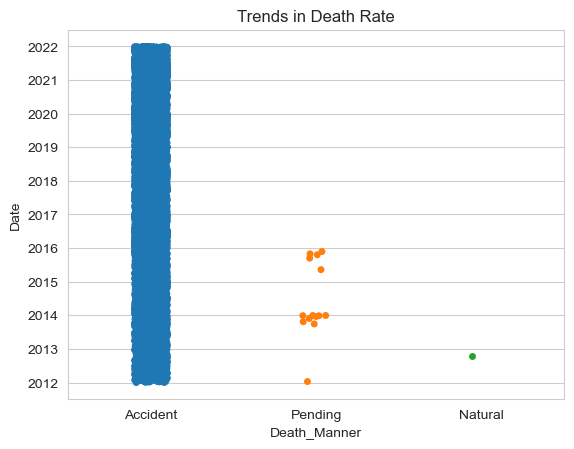

In [134]:
import seaborn as sns
sns.stripplot(data=drugs_accidents,y="Date",x='Death_Manner',jitter=True)
plt.title("Trends in Death Rate")
plt.show()

<AxesSubplot:title={'center':'Trends in death toll based on Age'}, xlabel='Age', ylabel='Incident'>

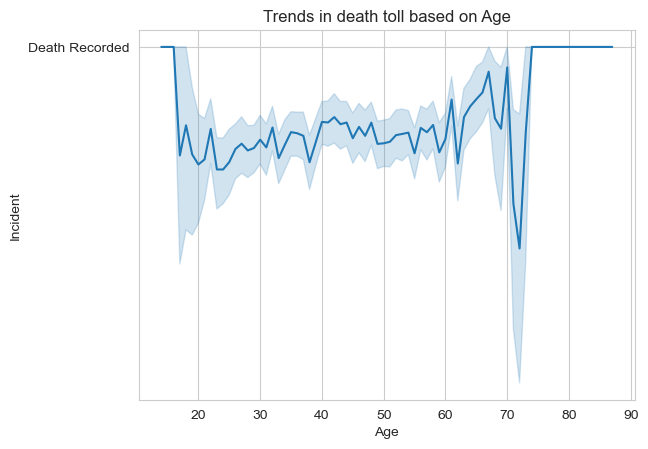

In [135]:

plt.title('Trends in death toll based on Age')
sns.lineplot(data=drugs_accidents,x='Age',y='Incident')


<AxesSubplot:xlabel='Incident', ylabel='count'>

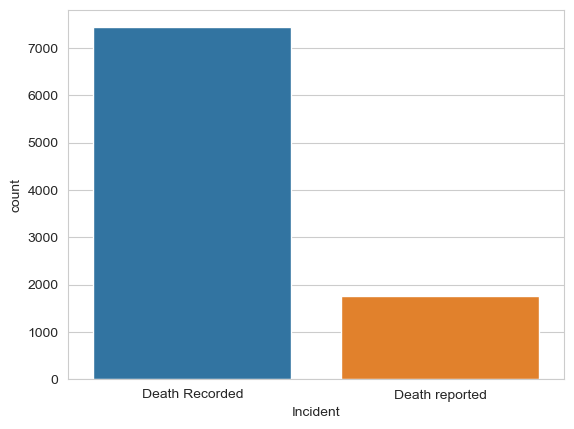

In [136]:
sns.countplot(data=drugs_accidents,x='Incident')

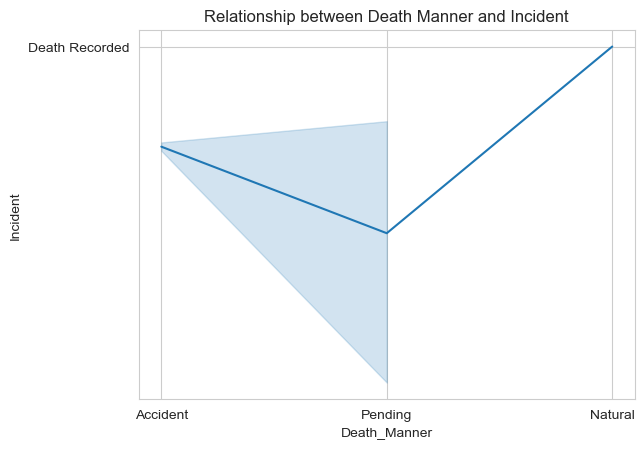

In [137]:
sns.lineplot(data=drugs_accidents,x='Death_Manner',y='Incident')
plt.title('Relationship between Death Manner and Incident')
plt.show()

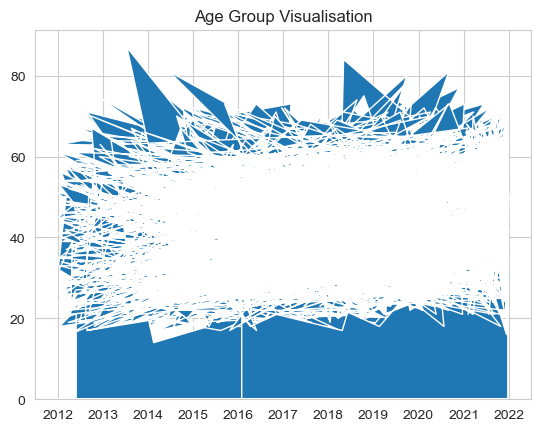

In [154]:
plt.stackplot(drugs_accidents['Date'],drugs_accidents['Age'])
plt.title('Age Group Visualisation')
plt.style.use('seaborn-whitegrid')
plt.show()

Text(0.5, 1.0, 'Association Between Drugs and Death')

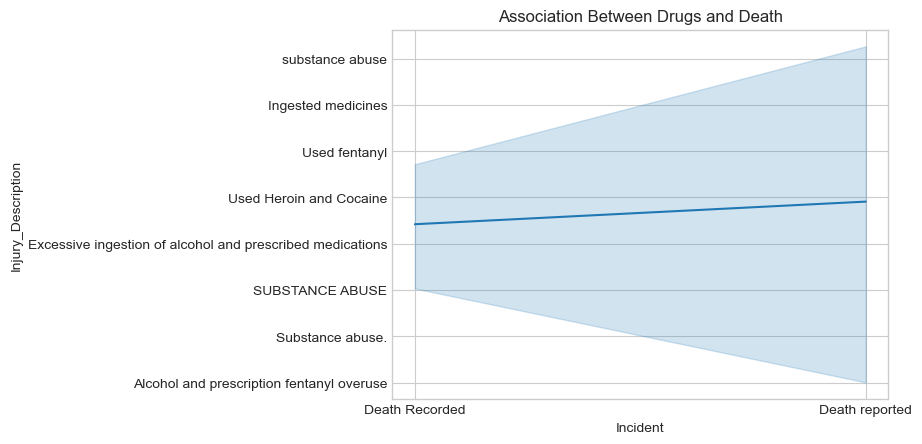

In [165]:
sns.lineplot(data=drugs_accidents,y=drugs_accidents.Injury_Description,x=drugs_accidents.Incident)
plt.style.use('seaborn-whitegrid')
plt.title("Association Between Drugs and Death")

Text(0.5, 1.0, 'Comparing Death Recorded and Reported between Age group ')

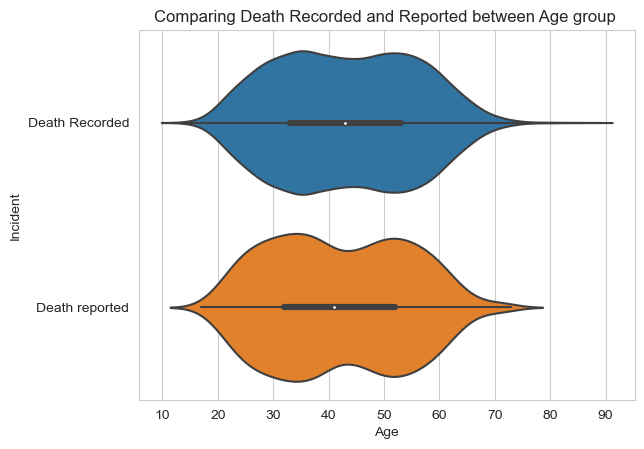

In [138]:
sns.violinplot(data=drugs_accidents,x='Age',y='Incident')
plt.title('Comparing Death Recorded and Reported between Age group ')

Text(0.5, 1.0, 'Death Toll in Recent years')

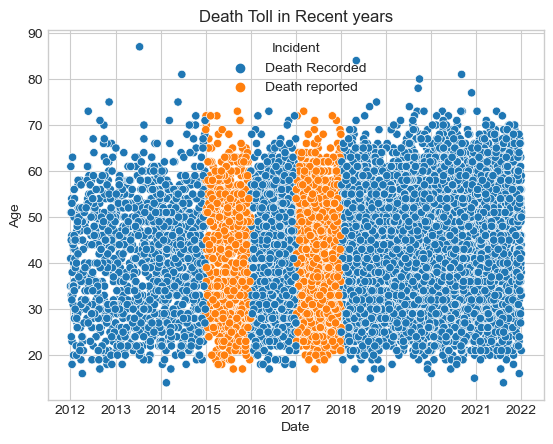

In [166]:
sns.scatterplot(data=drugs_accidents,x='Date',y="Age",hue='Incident')
plt.title('Death Toll in Recent years')

Text(0.5, 1.0, 'Comparing Deaths Rate Among County Based on their Age Group')

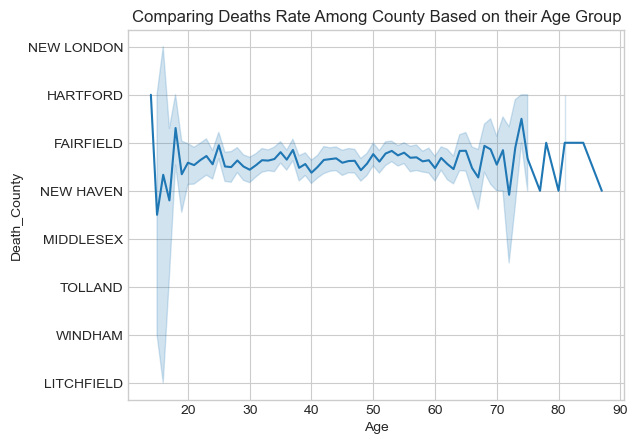

In [167]:
sns.lineplot(data=drugs_accidents,y='Death_County',x="Age")
plt.title('Comparing Deaths Rate Among County Based on their Age Group')

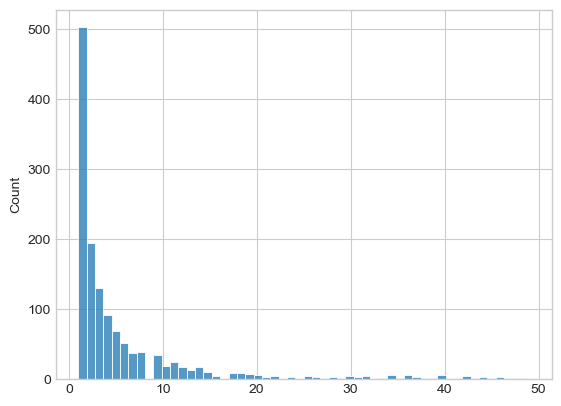

In [168]:
top51 = top5 = drugs_accidents.groupby(by=['Sex','Race','Age','Death_County'])['Cause_of_Death'].count()
top51 = np.array(top51)
sns.histplot(data=top51)
plt.show()

Text(0.5, 1.0, 'Death Manner Frequency Toll')

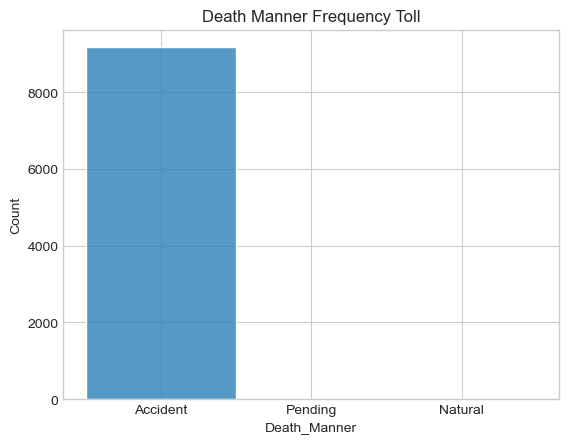

In [173]:
sns.histplot(data=drugs_accidents.Death_Manner)
plt.title("Death Manner Frequency Toll")

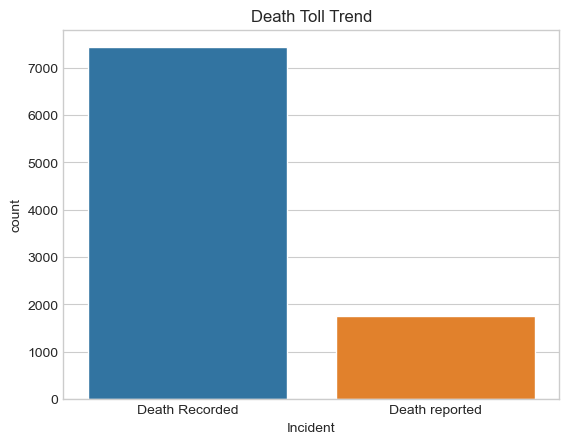

In [174]:
sns.countplot(data =drugs_accidents,x='Incident')
plt.title('Death Toll Trend')
plt.show()

Text(0.5, 1.0, ' Affected Race')

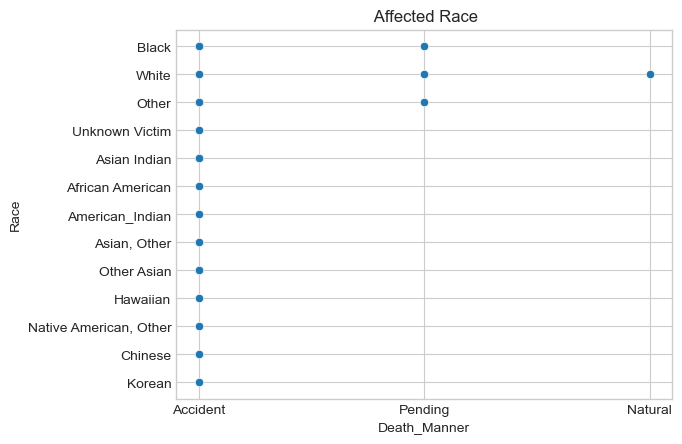

In [196]:
sns.scatterplot(data=drugs_accidents,x='Death_Manner',y='Race')
plt.title(' Affected Race')

Text(0.5, 1.0, 'Gender Death Places Based on Race')

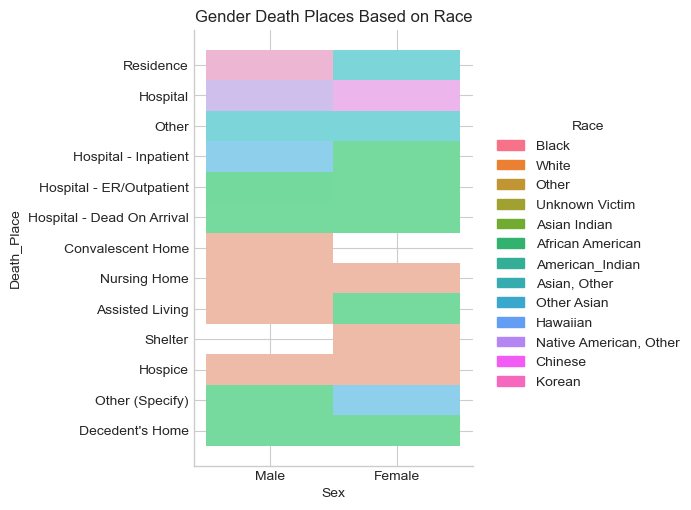

In [178]:
sns.displot(data=drugs_accidents,x='Sex',y='Death_Place',hue="Race")
plt.title('Drugs Accidents Trends Between Gender in Recent Years')
plt.title("Gender Death Places Based on Race")

Text(0.5, 1.0, 'Death Toll Trend in Recent Years Based on Race')

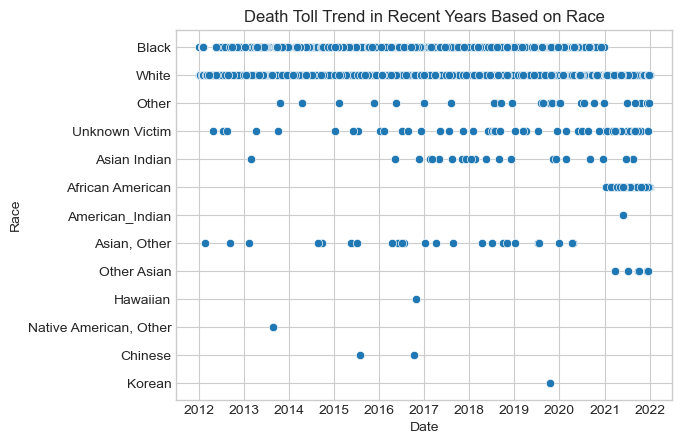

In [179]:
sns.scatterplot(data=drugs_accidents, x= "Date",y='Race')
plt.title("Death Toll Trend in Recent Years Based on Race")

In [ ]:
sns.stripplot(data=drugs_accidents,x='Date',y='Age',hue ='Sex')
plt.title('Ages of the Affected Victims')
plt.title("Age Categories")

<AxesSubplot:xlabel='Date', ylabel='Race'>

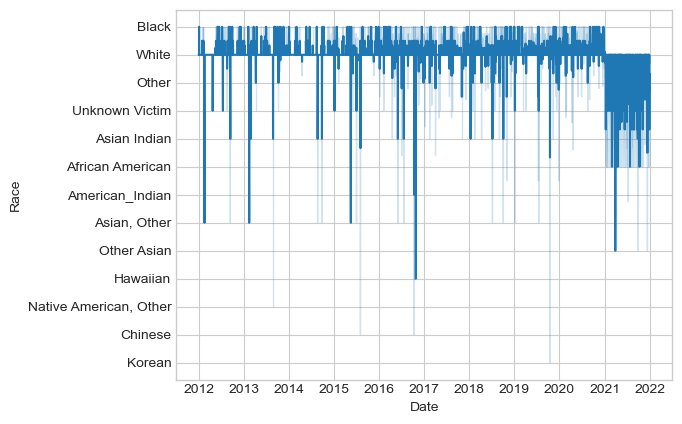

In [187]:
sns.lineplot(data=drugs_accidents,y='Race',x='Date')

Text(0.5, 1.0, 'Relationship Between Gender and Drugs_Accidents')

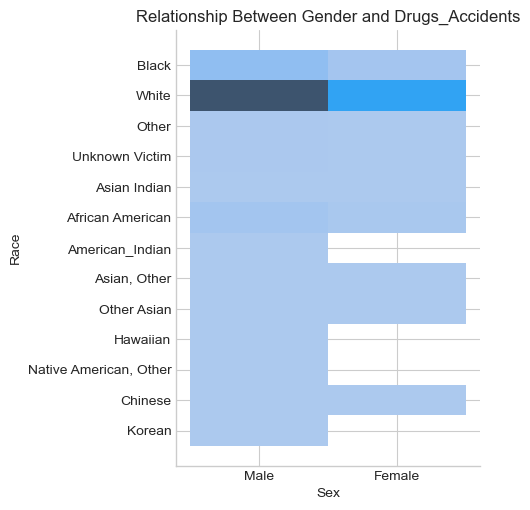

In [188]:
sns.displot(data=drugs_accidents,y='Race',x='Sex')
plt.title("Relationship Between Gender and Drugs_Accidents")

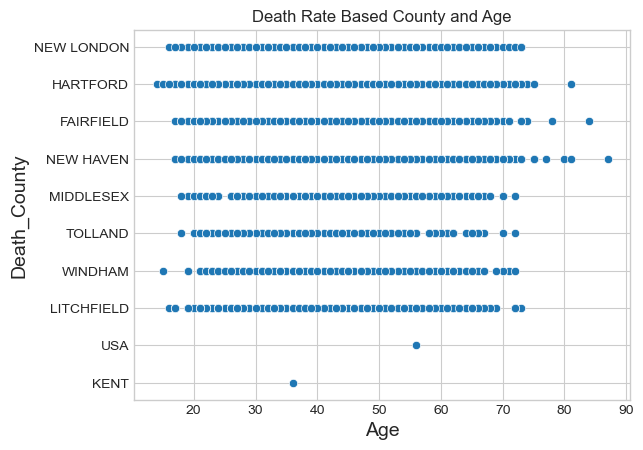

In [189]:
sns.scatterplot(data=drugs_accidents,y='Death_County',x='Age')
plt.xlabel('Age',fontsize=14);
plt.ylabel('Death_County',fontsize=14);
plt.title('Death Rate Based County and Age')
plt.show()

Text(0.5, 1.0, 'The County and State With Ilicit Drugs Usage and Death Toll')

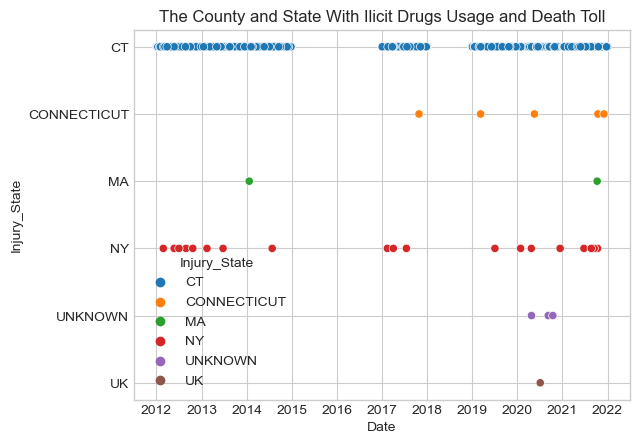

In [190]:
sns.scatterplot(data=drugs_accidents,x="Date",y='Injury_State',hue='Injury_State')
plt.title("The County and State With Ilicit Drugs Usage and Death Toll")

Text(0.5, 1.0, 'The Most Popular County With Ilicit Drugs Usage and Death Toll')

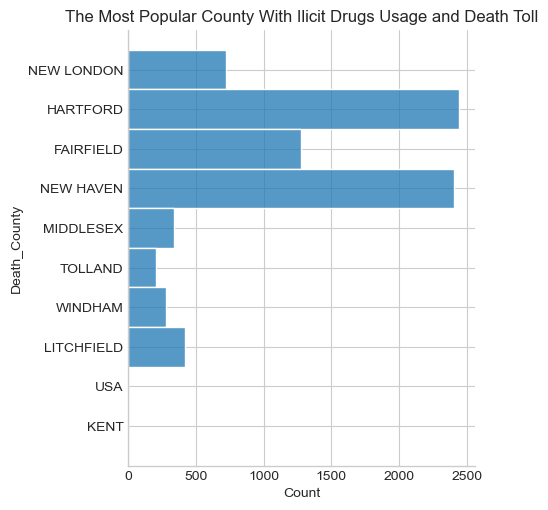

In [191]:
sns.displot(data=drugs_accidents,y='Death_County')
plt.title("The Most Popular County With Ilicit Drugs Usage and Death Toll")

On our graph Hartford is the most popular with drugs usage and death rate while Torland is the least

Text(0.5, 1.0, 'The Most Popular Drugs Residence States in Recent Years')

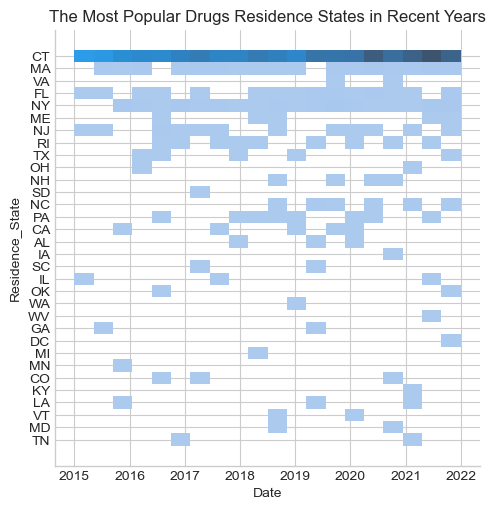

In [192]:
sns.displot(data=drugs_accidents,y='Residence_State',x="Date",kind='hist')
plt.title('The Most Popular Drugs Residence States in Recent Years')

The most top 5 popular States with the highest level of drug addiction is CT,MA,New york and Fl with a proportion of 1.0,0.9,0.8 and 0.9 respectively
ax = sns.swarmplot(data=drugs_accidents, x='Cause_of_Death',y='Death_Manner')
plt.title("Relationship between drugs and death rate",)

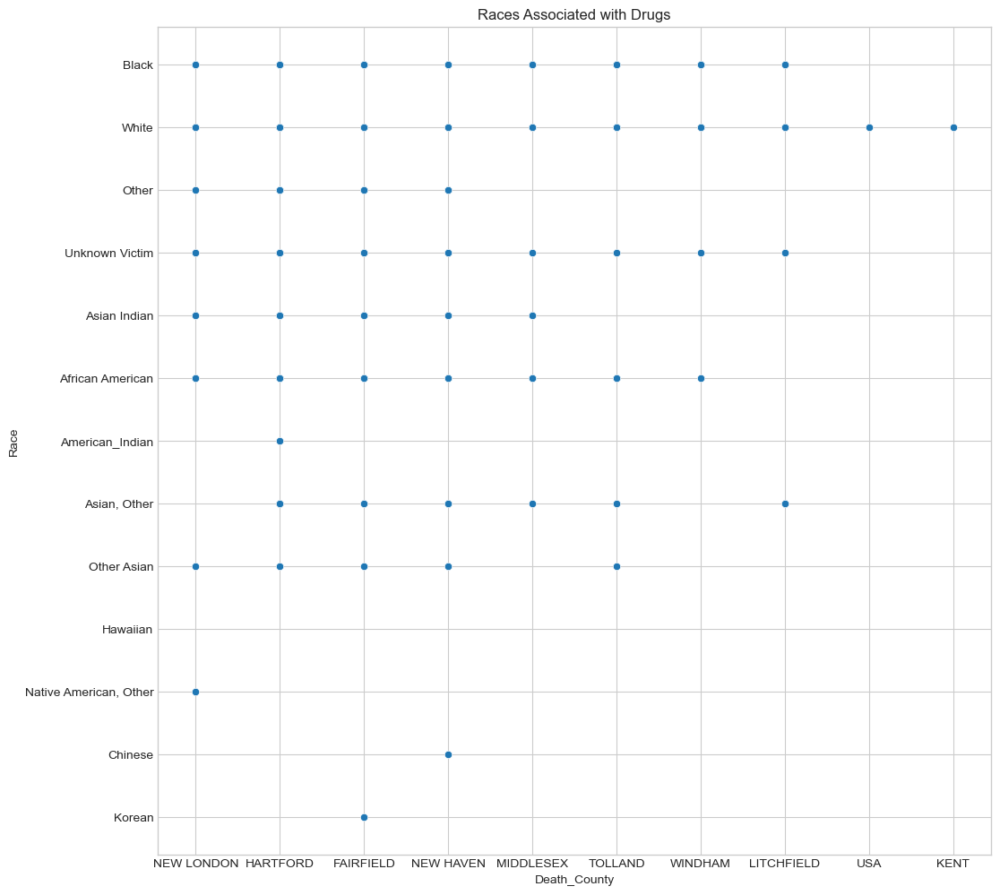

In [183]:
plt.figure(figsize=(12,12))
ax = sns.scatterplot(data=drugs_accidents,x='Death_County',y='Race')
plt.ylabel('Race')
plt.title('Races Associated with Drugs')
plt.show()

<Figure size 1200x1200 with 0 Axes>

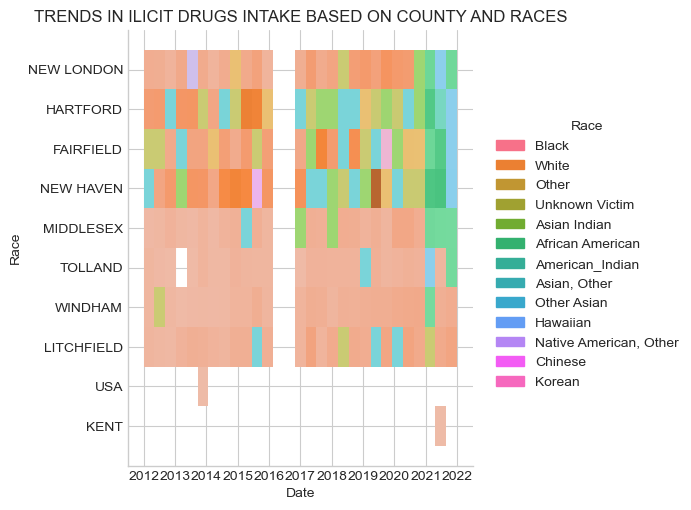

In [184]:
plt.figure(figsize=(12,12))
ax = sns.displot(data=drugs_accidents,y='Death_County',x='Date',hue='Race',kind='hist')
plt.ylabel('Race')
plt.title('TRENDS IN ILICIT DRUGS INTAKE BASED ON COUNTY AND RACES')
plt.show()

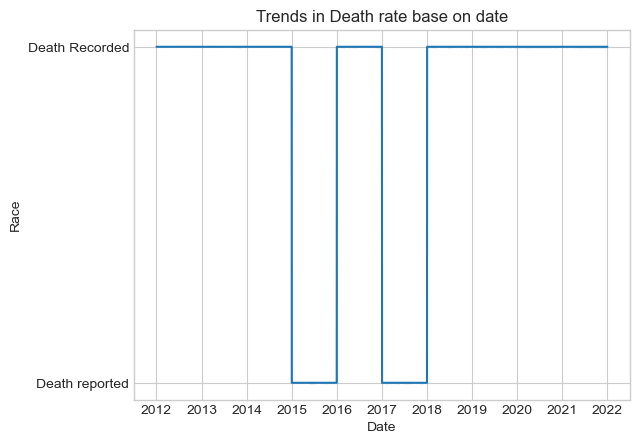

In [185]:

ax = sns.lineplot(data=drugs_accidents,x='Date',y='Incident')
plt.ylabel('Race')
plt.title('Trends in Death rate base on date')
plt.show()

Text(0.5, 1.0, 'Patterns in Death County and Race Related to Drugs')

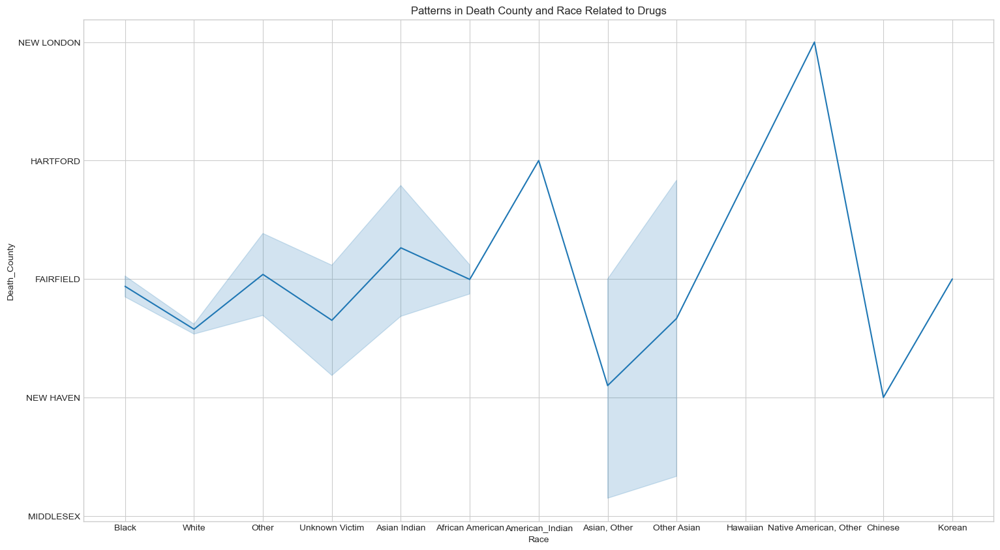

In [206]:
plt.figure(figsize=(18,10))
sns.lineplot(data=drugs_accidents,x='Race',y='Death_County')
plt.title('Patterns in Death County and Race Related to Drugs')

Text(0.5, 1.0, 'Manner of Death')

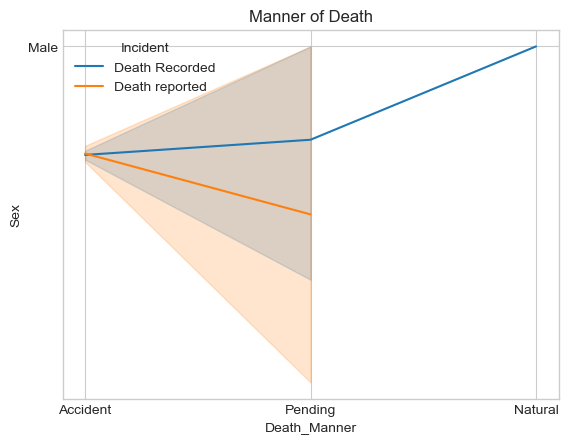

In [223]:
sns.lineplot(data=drugs_accidents,y='Sex',x='Death_Manner',hue ="Incident")
plt.title("Manner of Death")